### Objective : In this notebook we will play around with the spotify datasets and do the following things
                
    1. Read the pickle file of summarised datasets
    2. Train a word 2 vec model using skip gram with window size as a hyperparameters
    3. Play around with the vectors received from this excercise 
    4. Try creating two function which return most similar songs to particular songs
    5. Take 3 songs as list and return a playlist of 10 words

Results : 
    
Find Similar Songs using Word2vec
    
Searching for songs similar to : kashmir
    Similar songs are as follow
    
    kashmir - live: o2 arena, london - december 10, 2007
    
    killing in the name
    
    keep talking - 2011 remastered version
    
    immigrant song
    
    kickstart my heart - international
    
Searching for songs similar to : ['wonderwall', 'paradise', 'yellow', 'let her go', 'fireflies']
    Playlist based on your list is as follows
    won't go home without you
    
    you and your heart
    
    wherever you will go
    
    white houses
    
    wouldn't it be nice - 1999 - remaster
    
    you found me
    
    you give me something
    
    you and i both
    
    yellow - live
    
    where is the love?

### Load the required packages in the required format

In [1]:

import pandas as pd
import os
import warnings
import matplotlib.pyplot as plt
import seaborn as sns
import pickle
from sklearn.decomposition import PCA
from sklearn.manifold import TSNE
from umap.umap_ import UMAP

plt.style.use('ggplot')
import warnings
warnings.filterwarnings("ignore")

import gensim, logging
logging.basicConfig(format='%(asctime)s : %(levelname)s : %(message)s', level=logging.INFO)
#%matplotlib notebook

plt.style.use('ggplot')

In [235]:
### Read the datasets from the given locations and do following
filename = "spotify_dataset.csv"
### While Loading datasets we say error_bad_lines = false which drops rows with errors 
### As it is experimental project and we have huge datasets, dropping 100-200 Bad rows will not impact any results
print ("Reading the data")
spotify_data = pd.read_csv(filename,escapechar= '.',error_bad_lines = False,warn_bad_lines=False)
data = pd.read_csv('./data/train.csv')
print ("Read Succesful with shape {}".format(spotify_data.shape))
### Columns names were not very clean give them manual names
spotify_data.columns = ['user_id','artistname','trackname','playlistname']
#spotify_data = spotify_data.where(data.song_name.isin(spotify_data.trackname)).dropna().reset_index(drop=True)
#print("Shape after removing songs not in train set: {}".format(spotify_data.shape))

Reading the data
Read Succesful with shape (12774191, 4)
Shape after removing songs not in train set: (8448, 4)


### Lets look at the few stats about the data

In [236]:
print(data.shape)

(13184, 16)


In [237]:
print ("Some General statistics about data are as follows:",spotify_data.info())
print ("Lets look at the summary stats about the data :",spotify_data.describe(include ='object'))
print ("The number of rows in the datasets are as follows :",spotify_data.shape[0])
print (" The columns in the data are as follows :",spotify_data.columns)

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 8448 entries, 0 to 8447
Data columns (total 4 columns):
 #   Column        Non-Null Count  Dtype 
---  ------        --------------  ----- 
 0   user_id       8448 non-null   object
 1   artistname    8448 non-null   object
 2   trackname     8448 non-null   object
 3   playlistname  8448 non-null   object
dtypes: object(4)
memory usage: 264.1+ KB
Some General statistics about data are as follows: None
Lets look at the summary stats about the data :                                  user_id artistname trackname  \
count                               8448       8448      8448   
unique                                 6       2598      6891   
top     c50566d83fba17b20697039d5824db78       Kent    Let Go   
freq                                6713         93         7   

              playlistname  
count                 8448  
unique                  63  
top     Everything at once  
freq                  5058  
The number of rows in the

In [238]:
### Now lets define function which creates a dictionary and convert songs names to dictionary

tracklist = spotify_data['trackname'].unique()

In [239]:
spotify_data.dropna(inplace = True)

In [240]:
### Create a function which takes a dataset name and column name 

def create_dict(dataset, column):
    ''' Takes two input from user column name and dataset name and return dictionary with hash map '''
    unique_list = dataset[column].unique()
    out_dict = {}
    out_dict1 = {}
    
    for j,i in enumerate(unique_list):
        out_dict[i.lower()] = str(j)
        out_dict1[str(j)] = i.lower()
        
    print ("Number of distinct in vocab is :",j)
    return (out_dict,out_dict1)

In [241]:
### call the dict functions on track names and artistname
track_map, track_map_comp= create_dict(spotify_data,'trackname')
artist_map,artist_map_comp = create_dict(spotify_data,'artistname')

Number of distinct in vocab is : 6890
Number of distinct in vocab is : 2597


### We created two dicts as will first need to convert songs to numeric mapping and after we have trained the model we will return numeric to song mapping

In [242]:
with open('track_map_dict.pickle','wb') as track_file:
    pickle.dump(track_map,track_file)
with open('track_map_comp_dict.pickle','wb') as track_file_comp:
    pickle.dump(track_map_comp,track_file_comp)

In [243]:
with open('artist_map_dict.pickle','wb') as artist_file:
    pickle.dump(artist_map,artist_file)
with open('artist_map_comp_dict.pickle','wb') as artist_file_comp:
    pickle.dump(artist_map_comp,artist_file_comp)

### Data Processing For Word2vec models 
##### 1. Convert each artist name & song name to numeric using the dictionary first
##### 2. Roll up the data at User_id and Playlist level, and store songss in a playlist as list. Before doing that we will like to shuffle the datasets
##### 3. Train a word 2 vector model, and see how it works 

In [244]:
### Lets shuffle the data first
print ("Shape of data before sampling is:", spotify_data.shape)
spotify_data.sample(frac = 1,  random_state = 10000).reset_index(drop=True)
print ("Shape of data after sampling is :", spotify_data.shape)

Shape of data before sampling is: (8448, 4)
Shape of data after sampling is : (8448, 4)


In [245]:
### Load the pickle files stored for song to numeric 
with open('./pickle/track_map_dict.pickle','rb') as dict1:
    track_dict= pickle.load( dict1)
print ("Track dict has {} observations".format(len(track_dict)))
#### Load the prcikle file for artist to numeric
with open('artist_map_dict.pickle','rb') as dict2:
    artist_dict = pickle.load(dict2)
print ("Track dict has {} observations".format(len(artist_dict)))

Track dict has 6868 observations
Track dict has 2597 observations


In [246]:
### Now we will use this mapping to convert names to numeric
print ("Data before mapping dict :", spotify_data.head(5))
spotify_data['trackname'] = spotify_data['trackname'].str.lower().map(track_dict)
spotify_data['artistname'] = spotify_data['artistname'].str.lower().map(artist_dict)
print ("Data after mapping dict :")
print (spotify_data.head(5))

Data before mapping dict :                             user_id                        artistname  \
0  9cc0cfd4d7d7885102480dd99e7a90d6  Elvis Costello & The Attractions   
1  9cc0cfd4d7d7885102480dd99e7a90d6  Elvis Costello & The Attractions   
2  9cc0cfd4d7d7885102480dd99e7a90d6                    Elvis Costello   
3  9cc0cfd4d7d7885102480dd99e7a90d6                            Lissie   
4  9cc0cfd4d7d7885102480dd99e7a90d6                    Paul McCartney   

                                           trackname    playlistname  
0  (What's So Funny 'Bout) Peace, Love And Unders...  HARD ROCK 2010  
1                              Accidents Will Happen  HARD ROCK 2010  
2                                             Alison  HARD ROCK 2010  
3                                        All Be Okay  HARD ROCK 2010  
4                                    Band On The Run  HARD ROCK 2010  
Data after mapping dict :
                            user_id artistname trackname    playlistname
0  9cc0cf

In [247]:
### We want to create a list of songs in zip file 
def zip_list(x):
    return ([str(z) for z in x])

#### Lets group by data based on the user id and playlist and zip it as a list

In [248]:
spotify_summary = spotify_data.groupby(['user_id','playlistname'])['trackname'].apply(zip_list).reset_index()

In [249]:
print (" Distinct playlist after summarizing the data is :",spotify_summary.shape[0])
print (" The data looks like this :")
print (spotify_summary.head(5))

 Distinct playlist after summarizing the data is : 64
 The data looks like this :
                            user_id playlistname  \
0  07f0fc3be95dcd878966b1f9572ff670         2080   
1  07f0fc3be95dcd878966b1f9572ff670         C418   
2  07f0fc3be95dcd878966b1f9572ff670    Chill out   
3  07f0fc3be95dcd878966b1f9572ff670    Classique   
4  07f0fc3be95dcd878966b1f9572ff670   Daft Punk    

                                           trackname  
0                               [69, 70, 71, 72, 73]  
1  [74, 75, 76, 77, 78, 79, 80, 81, 82, 83, 84, 8...  
2  [95, 96, 97, 98, 99, 100, 101, 102, 103, 104, ...  
3  [188, 189, 190, 191, 192, 193, 194, 195, 196, ...  
4  [207, 208, 209, 210, 211, 212, 213, 214, 215, ...  


In [250]:
### We will Dump this data in the pickle file and work in it later
with open("./pickle/spotify_summary.pickle",'wb') as pick_data:
    pickle.dump(spotify_summary,pick_data)
    print ("./pickle/The dataset is pickled at ",os.getcwd())

The dataset is pickled at  C:\Users\Alvaro\OneDrive - Universidad Politécnica de Madrid\MCP\song_popularity_mcp


In [251]:
### Load the pickled datasets 
with open('./pickle/spotify_summary.pickle','rb') as dataset:
    spotify_summary = pickle.load(dataset)
    print (" The dataset is loaded succesfully")
    print (" The shape of the dataset is as follows",spotify_summary.shape)
    print (spotify_summary.head(5))

 The dataset is loaded succesfully
 The shape of the dataset is as follows (64, 3)
                            user_id playlistname  \
0  07f0fc3be95dcd878966b1f9572ff670         2080   
1  07f0fc3be95dcd878966b1f9572ff670         C418   
2  07f0fc3be95dcd878966b1f9572ff670    Chill out   
3  07f0fc3be95dcd878966b1f9572ff670    Classique   
4  07f0fc3be95dcd878966b1f9572ff670   Daft Punk    

                                           trackname  
0                               [69, 70, 71, 72, 73]  
1  [74, 75, 76, 77, 78, 79, 80, 81, 82, 83, 84, 8...  
2  [95, 96, 97, 98, 99, 100, 101, 102, 103, 104, ...  
3  [188, 189, 190, 191, 192, 193, 194, 195, 196, ...  
4  [207, 208, 209, 210, 211, 212, 213, 214, 215, ...  


In [252]:
### Gensim takes input as a list of list. Our tracknames are already a list convert them to list of list
spotify_wrd2vec_input = [ x for x in spotify_summary['trackname']]
print ("Input data is ready for gensim models")
print ("The number of input playlists we have are as follows :",len(spotify_wrd2vec_input))

Input data is ready for gensim models
The number of input playlists we have are as follows : 64


In [255]:
### Define traing the word 2 vec model we will use Skip Gram using negative sampling as oftmax can be slow
# seed = 1000, hs = 0,negative = 10,workers=10,epochs = 100
### Skip Gram : Predict Context given the middle word works well with infrequent datasets.
### Good idea for songs as some songs may ne liked by a few users oly
print ("Model Training has started")
model = gensim.models.Word2Vec(spotify_wrd2vec_input, vector_size = 200 , window = 4 , min_count = 15,
                               seed = 1000, hs = 0,negative = 10,workers=16,epochs = 100)
print ("Model Trainin Finished")

2022-11-26 16:07:51,513 : INFO : collecting all words and their counts
2022-11-26 16:07:51,514 : INFO : PROGRESS: at sentence #0, processed 0 words, keeping 0 word types
2022-11-26 16:07:51,517 : INFO : collected 6868 word types from a corpus of 8448 raw words and 64 sentences
2022-11-26 16:07:51,518 : INFO : Creating a fresh vocabulary
2022-11-26 16:07:51,521 : INFO : Word2Vec lifecycle event {'msg': 'effective_min_count=15 retains 0 unique words (0.00% of original 6868, drops 6868)', 'datetime': '2022-11-26T16:07:51.521651', 'gensim': '4.2.0', 'python': '3.10.8 (tags/v3.10.8:aaaf517, Oct 11 2022, 16:50:30) [MSC v.1933 64 bit (AMD64)]', 'platform': 'Windows-10-10.0.22621-SP0', 'event': 'prepare_vocab'}
2022-11-26 16:07:51,522 : INFO : Word2Vec lifecycle event {'msg': 'effective_min_count=15 leaves 0 word corpus (0.00% of original 8448, drops 8448)', 'datetime': '2022-11-26T16:07:51.522677', 'gensim': '4.2.0', 'python': '3.10.8 (tags/v3.10.8:aaaf517, Oct 11 2022, 16:50:30) [MSC v.1933 

Model Training has started


RuntimeError: you must first build vocabulary before training the model

In [ ]:
### Pickle the model datasets and save it to a pickle file 

with open('./pickle/model_spotify_word2vec.pickle','wb') as model_file:
    pickle.dump(model,model_file)
    print (" Dumping the model succesful ")
    print (" The model is dumped at this location :",os.getcwd())

 Dumping the model succesful 
 The model is dumped at this location : C:\Users\Alvaro\OneDrive - Universidad Politécnica de Madrid\MCP\song_popularity_mcp


In [ ]:
### From the dump load the model dictionary and model pickle files
with open('./pickle/model_spotify_word2vec.pickle','rb') as model_file:
    model_spotify = pickle.load(model_file)

### Load the pickle files stored for song to numeric 
with open('./pickle/track_map_dict.pickle','rb') as dict1:
    track_dict= pickle.load( dict1)
print ("Track dict has {} observations".format(len(track_dict)))
#### Load the prcikle file for artist to numeric
with open('./pickle/track_map_comp_dict.pickle','rb') as dict2:
    track_map_comp_dict = pickle.load(dict2)
print ("Track dict has {} observations".format(len(track_map_comp_dict)))

Track dict has 1866246 observations
Track dict has 1978500 observations


### Define a function which return similar songs to a particular songs

In [ ]:
#### Define a function which takes as input songs from list and returns similar songs
def similar_songs(songname,n):
    ''' Gets the songname from user and return the n songs similar'''
    song_id = track_dict[songname]
    print ("Searching for songs similar to :",songname)
    
    similar = model_spotify.wv.most_similar(song_id,topn = n)
    print ("Similar songs are as follow")
    for i in similar[:]:
        print (track_map_comp_dict[i[0]])

### Define a function which takes list of songs and creates playlist for the users

In [ ]:
#### Define a function which takes as input songs from list and returns similar songs
def create_play_list(list_songs,n):
    ''' Gets the songname from user and return the 5 songs similar'''  
    list1 = []
    for i in list_songs:
        list1.append(track_dict[i])      
        
    print ("Searching for songs similar to :",list_songs)
    
    similar = model_spotify.wv.most_similar(positive = list1,topn = n)
    print ("Playlist based on your list is as follows")
    for i in similar[:]:
        print (track_map_comp_dict[i[0]])

### Lets check out results for my favourite songs list 

In [ ]:
create_play_list(['wonderwall','paradise','yellow','let her go','fireflies'],10)

Searching for songs similar to : ['wonderwall', 'paradise', 'yellow', 'let her go', 'fireflies']
Playlist based on your list is as follows
you and i both
you could be happy
world spins madly on
won't go home without you
you and your heart
viva la vida - live
wild world
you give me something
wonderful tonight
wonderwall - remastered


In [ ]:
### Lets check the results for a different music taste - Classic Metal | Rock

In [ ]:
create_play_list(['enter sandman','fade to black','kashmir'],15)

Searching for songs similar to : ['enter sandman', 'fade to black', 'kashmir']
Playlist based on your list is as follows
fear of the dark - 1998 remastered version
eye of the tiger
fairies wear boots
everlong
entre dos tierras
estranged
even flow
du hast
fortunate son
faint
for whom the bell tolls
dream on
fear of the dark
ett slag färgat rött
fast as a shark


### Try a different list of songs

In [ ]:
create_play_list(['hey you','time','hypnotised','fix you'],10)

Searching for songs similar to : ['hey you', 'time', 'hypnotised', 'fix you']
Playlist based on your list is as follows
hänsyn
high speed
home
holiday
hallelujah
hey there delilah
hide and seek
human
glorious
hey you - live


###  find out similar songs Kashmir by Led Zepplin

In [ ]:
similar_songs('kashmir',5)

Searching for songs similar to : kashmir
Similar songs are as follow
kashmir - live: o2 arena, london - december 10, 2007
immigrant song
karma police
kickstart my heart
keep talking - 2011 remastered version


Vamos a mapear los w2v a las canciones del dataset original

In [ ]:
data['song_w2v_id'] = data['song_name'].str.lower().map({v: k for k, v in track_map_comp_dict.items()})

In [ ]:
data.shape[0] - data['song_w2v_id'].isna().sum()

8815

In [ ]:
data['song_w2v'] = data['song_w2v_id'].apply(lambda x: model_spotify.wv[x] if x in model_spotify.wv else pd.NA)

In [ ]:
data

,song_id,song_name,song_popularity,song_duration_ms,acousticness,danceability,energy,instrumentalness,key,liveness,loudness,audio_mode,speechiness,tempo,time_signature,audio_valence,song_w2v_id,song_w2v
0,2231,Maneater - Radio Edit,58,270946,0.01530,0.728,0.518,0.000042,11,0.1030,-11.114,0,0.0380,88.708,4,0.833,NaN,<NA>
1,18680,Better Off Alone,62,192835,0.01550,0.903,0.498,0.000008,8,0.1050,-6.379,1,0.1080,121.974,4,0.439,673844,"[2.3930256, -0.5403114, 0.71559143, -0.1178641..."
2,16908,Song That I Heard,59,237666,0.77300,0.267,0.356,0.001760,8,0.1670,-12.103,1,0.0317,92.272,4,0.314,NaN,<NA>
3,10155,Zumba,60,263973,0.00205,0.729,0.894,0.021000,5,0.1280,-3.494,1,0.0397,124.992,4,0.832,788783,"[-0.549021, 0.7988258, 0.89703345, 0.7639909, ..."
4,18150,Bumper To Bumper,31,225933,0.14800,0.771,0.735,0.000000,5,0.2880,-9.162,0,0.1160,119.983,4,0.385,1523933,<NA>
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
13179,8730,WORKIN ME,86,169620,0.18200,0.790,0.629,0.000007,8,0.3380,-4.055,1,0.1420,170.023,4,0.267,NaN,<NA>
13180,17365,Nobody Wants to Be Lonely - Ricky Martin with ...,53,252706,0.00579,0.635,0.854,0.008300,10,0.0623,-5.020,0,0.0612,100.851,4,0.590,159428,"[-0.36609915, -0.6245905, 0.9947883, -2.949333..."
13181,3236,Sinking Ship,53,247493,0.95000,0.370,0.174,0.002900,4,0.1100,-19.316,0,0.0377,92.750,4,0.181,60085,"[0.05822057, 0.37851387, 0.30738366, 1.0028217..."
13182,3161,The Light,76,179653,0.01780,0.830,0.577,0.000081,4,0.0436,-5.156,0,0.2560,92.973,4,0.630,12605,"[1.2457492, -2.7265966, -0.5348976, -0.9461306..."


In [ ]:
#data.loc[data.song_w2v.notna(), w2v_df.columns] = w2v_df

In [119]:
subset_threshold = 50
subset_index = np.hstack([np.arange(0, subset_threshold), np.arange(sum(data.song_w2v.notna())-subset_threshold, sum(data.song_w2v.notna()))])

In [103]:
w2v_df = pd.DataFrame(data.song_w2v.dropna().tolist(), columns=[f'w2v_{i}' for i in range(200)])

In [104]:
w2v_df

,w2v_0,w2v_1,w2v_2,w2v_3,w2v_4,w2v_5,w2v_6,w2v_7,w2v_8,w2v_9,...,w2v_190,w2v_191,w2v_192,w2v_193,w2v_194,w2v_195,w2v_196,w2v_197,w2v_198,w2v_199
0,2.393026,-0.540311,0.715591,-0.117864,-0.156962,1.721114,3.175997,-2.485858,-0.086490,1.505383,...,1.079074,1.495943,0.221243,-2.142076,1.735291,1.073014,-0.716155,-2.620877,-0.648852,-0.092089
1,-0.549021,0.798826,0.897033,0.763991,0.285272,0.584823,-1.160702,-0.828137,-1.873722,3.187523,...,0.601308,1.789231,0.798233,-0.912394,-1.125932,-0.779473,1.909184,0.098160,0.546059,-0.628364
2,-0.390244,1.503479,1.506688,0.624133,-0.845099,-1.117069,0.885601,-0.553040,-0.634734,0.800990,...,1.006318,-0.526002,1.285471,-0.467943,1.489178,-1.464805,0.813573,0.805942,-0.411207,-0.649696
3,1.451252,-1.733374,-0.495926,1.645622,1.035882,-2.201953,1.502697,-2.447964,0.970345,0.683925,...,-0.477378,-2.205733,-1.840135,-0.187641,-3.495541,-2.139970,-1.880289,0.666905,-2.250687,-1.030113
4,0.522433,0.692891,0.731870,-1.624638,-2.375382,1.363982,2.794656,-2.469477,1.550724,1.805525,...,-0.792091,-2.072329,0.150978,0.270374,-0.059911,1.071282,-0.872493,-1.425604,-2.994303,0.550731
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
6992,2.017431,0.963526,0.759613,1.941678,-0.842052,-1.922511,-0.557227,-1.000135,0.898750,1.999336,...,0.506240,-2.074746,-1.075751,-1.157100,-1.321489,-1.193351,0.738239,-2.017063,-0.144427,0.205557
6993,-0.366099,-0.624591,0.994788,-2.949334,0.271060,-0.959073,-0.666339,-1.069606,-1.355448,0.073991,...,0.052917,-0.189539,1.725211,0.780943,-0.211630,-1.018645,-0.003973,0.276466,-0.825413,-1.523416
6994,0.058221,0.378514,0.307384,1.002822,-0.893269,0.334821,-0.933849,-0.266850,-0.838095,-0.858124,...,-0.584435,1.011904,0.786440,-1.122558,1.260289,0.694857,-0.931256,0.221868,-0.240352,-0.883626
6995,1.245749,-2.726597,-0.534898,-0.946131,-0.626404,-1.429458,-4.348206,2.259085,-3.361431,-0.055088,...,-0.545180,0.332396,0.423678,2.992852,4.465190,1.334477,1.979462,1.246077,-0.443022,0.487951


In [110]:
w2v_target = data.loc[data.song_w2v.notna(),'song_popularity'].reset_index(drop=True)

In [111]:
w2v_target

0       62
1       60
2       38
3       14
4       86
        ..
6992    69
6993    53
6994    53
6995    76
6996    64
Name: song_popularity, Length: 6997, dtype: int64

In [112]:
w2v_names = data.loc[data.song_w2v.notna(),'song_name'].reset_index(drop=True)

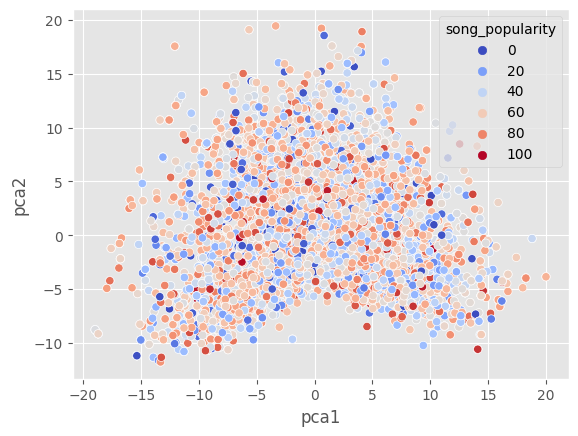

In [ ]:
# Use pca to reduce the dimensionality of the data
from sklearn.decomposition import PCA
pca = PCA(n_components=2)
pca.fit(w2v_df)
w2v_pca = pd.DataFrame(pca.transform(w2v_df), columns=['pca1', 'pca2'])

import seaborn as sns
import matplotlib.pyplot as plt

sns.scatterplot(x='pca1', y='pca2', data=w2v_pca, hue=w2v_target, palette='coolwarm')
plt.show()

In [ ]:
w2v_pca

array([[-4.8981767 , -6.2121096 ],
       [ 0.28828567, -2.7676568 ],
       [-3.2965803 , -1.1521248 ],
       ...,
       [ 5.0708756 , -0.94026613],
       [11.399658  , -4.9837265 ],
       [-2.9107301 , -2.5791311 ]], dtype=float32)

[t-SNE] Computing 16 nearest neighbors...
[t-SNE] Indexed 6997 samples in 0.007s...
[t-SNE] Computed neighbors for 6997 samples in 1.562s...
[t-SNE] Computed conditional probabilities for sample 1000 / 6997
[t-SNE] Computed conditional probabilities for sample 2000 / 6997
[t-SNE] Computed conditional probabilities for sample 3000 / 6997
[t-SNE] Computed conditional probabilities for sample 4000 / 6997
[t-SNE] Computed conditional probabilities for sample 5000 / 6997
[t-SNE] Computed conditional probabilities for sample 6000 / 6997
[t-SNE] Computed conditional probabilities for sample 6997 / 6997
[t-SNE] Mean sigma: 0.000000
[t-SNE] KL divergence after 250 iterations with early exaggeration: 92.950157
[t-SNE] KL divergence after 300 iterations: 3.626673


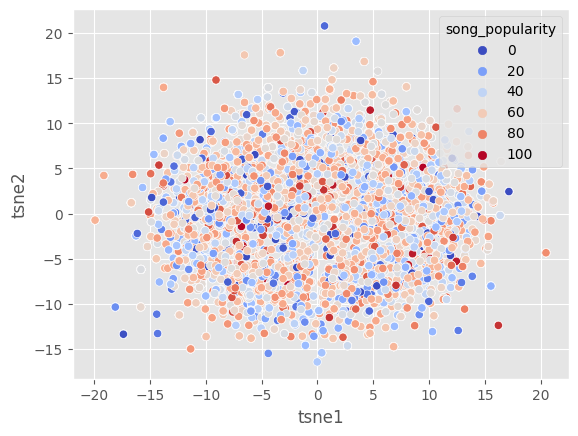

[t-SNE] Computing 19 nearest neighbors...
[t-SNE] Indexed 6997 samples in 0.005s...
[t-SNE] Computed neighbors for 6997 samples in 1.552s...
[t-SNE] Computed conditional probabilities for sample 1000 / 6997
[t-SNE] Computed conditional probabilities for sample 2000 / 6997
[t-SNE] Computed conditional probabilities for sample 3000 / 6997
[t-SNE] Computed conditional probabilities for sample 4000 / 6997
[t-SNE] Computed conditional probabilities for sample 5000 / 6997
[t-SNE] Computed conditional probabilities for sample 6000 / 6997
[t-SNE] Computed conditional probabilities for sample 6997 / 6997
[t-SNE] Mean sigma: 0.000000
[t-SNE] KL divergence after 250 iterations with early exaggeration: 92.892967
[t-SNE] KL divergence after 300 iterations: 3.566444


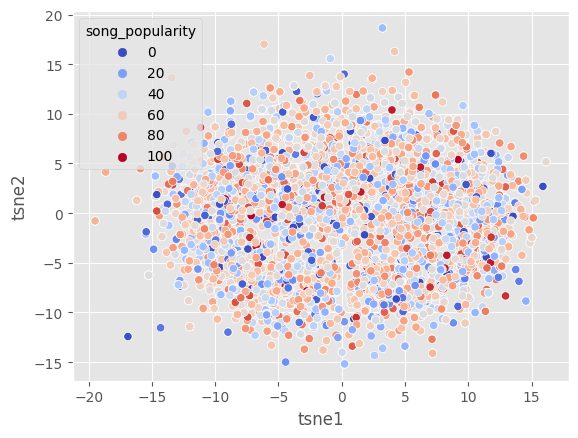

[t-SNE] Computing 22 nearest neighbors...
[t-SNE] Indexed 6997 samples in 0.005s...
[t-SNE] Computed neighbors for 6997 samples in 1.557s...
[t-SNE] Computed conditional probabilities for sample 1000 / 6997
[t-SNE] Computed conditional probabilities for sample 2000 / 6997
[t-SNE] Computed conditional probabilities for sample 3000 / 6997
[t-SNE] Computed conditional probabilities for sample 4000 / 6997
[t-SNE] Computed conditional probabilities for sample 5000 / 6997
[t-SNE] Computed conditional probabilities for sample 6000 / 6997
[t-SNE] Computed conditional probabilities for sample 6997 / 6997
[t-SNE] Mean sigma: 0.000000
[t-SNE] KL divergence after 250 iterations with early exaggeration: 92.938278
[t-SNE] KL divergence after 300 iterations: 3.511097


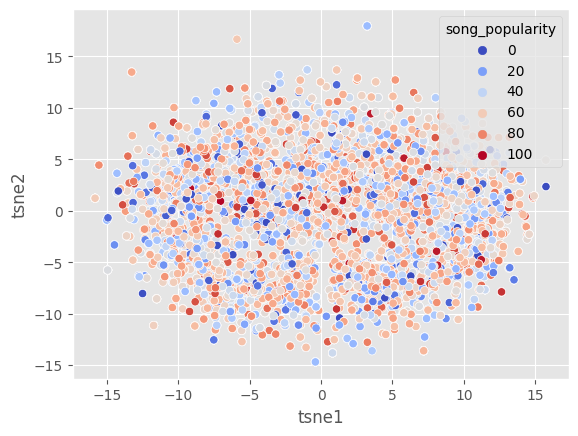

[t-SNE] Computing 25 nearest neighbors...
[t-SNE] Indexed 6997 samples in 0.006s...
[t-SNE] Computed neighbors for 6997 samples in 1.524s...
[t-SNE] Computed conditional probabilities for sample 1000 / 6997
[t-SNE] Computed conditional probabilities for sample 2000 / 6997
[t-SNE] Computed conditional probabilities for sample 3000 / 6997
[t-SNE] Computed conditional probabilities for sample 4000 / 6997
[t-SNE] Computed conditional probabilities for sample 5000 / 6997
[t-SNE] Computed conditional probabilities for sample 6000 / 6997
[t-SNE] Computed conditional probabilities for sample 6997 / 6997
[t-SNE] Mean sigma: 0.000000
[t-SNE] KL divergence after 250 iterations with early exaggeration: 92.882477
[t-SNE] KL divergence after 300 iterations: 3.448520


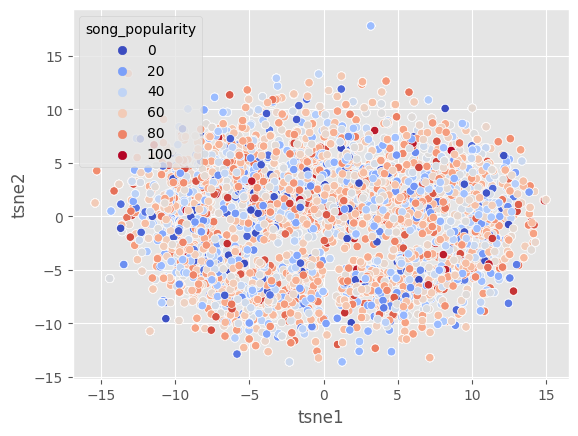

[t-SNE] Computing 28 nearest neighbors...
[t-SNE] Indexed 6997 samples in 0.006s...
[t-SNE] Computed neighbors for 6997 samples in 1.537s...
[t-SNE] Computed conditional probabilities for sample 1000 / 6997
[t-SNE] Computed conditional probabilities for sample 2000 / 6997
[t-SNE] Computed conditional probabilities for sample 3000 / 6997
[t-SNE] Computed conditional probabilities for sample 4000 / 6997
[t-SNE] Computed conditional probabilities for sample 5000 / 6997
[t-SNE] Computed conditional probabilities for sample 6000 / 6997
[t-SNE] Computed conditional probabilities for sample 6997 / 6997
[t-SNE] Mean sigma: 0.000000
[t-SNE] KL divergence after 250 iterations with early exaggeration: 92.934883
[t-SNE] KL divergence after 300 iterations: 3.392684


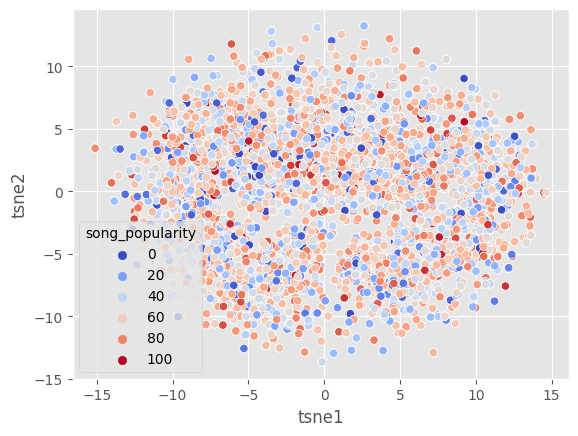

[t-SNE] Computing 31 nearest neighbors...
[t-SNE] Indexed 6997 samples in 0.005s...
[t-SNE] Computed neighbors for 6997 samples in 1.541s...
[t-SNE] Computed conditional probabilities for sample 1000 / 6997
[t-SNE] Computed conditional probabilities for sample 2000 / 6997
[t-SNE] Computed conditional probabilities for sample 3000 / 6997
[t-SNE] Computed conditional probabilities for sample 4000 / 6997
[t-SNE] Computed conditional probabilities for sample 5000 / 6997
[t-SNE] Computed conditional probabilities for sample 6000 / 6997
[t-SNE] Computed conditional probabilities for sample 6997 / 6997
[t-SNE] Mean sigma: 0.000000
[t-SNE] KL divergence after 250 iterations with early exaggeration: 92.904709
[t-SNE] KL divergence after 300 iterations: 3.330225


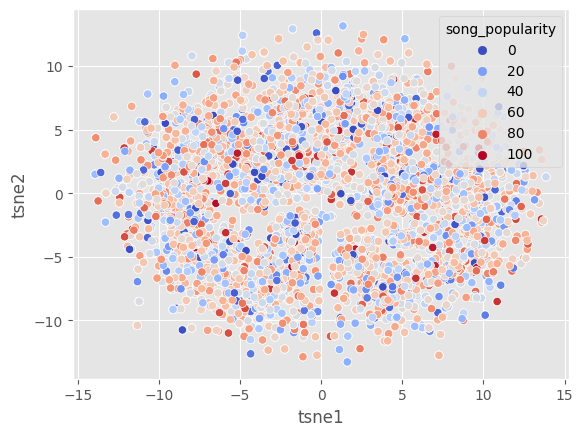

[t-SNE] Computing 34 nearest neighbors...
[t-SNE] Indexed 6997 samples in 0.006s...
[t-SNE] Computed neighbors for 6997 samples in 1.547s...
[t-SNE] Computed conditional probabilities for sample 1000 / 6997
[t-SNE] Computed conditional probabilities for sample 2000 / 6997
[t-SNE] Computed conditional probabilities for sample 3000 / 6997
[t-SNE] Computed conditional probabilities for sample 4000 / 6997
[t-SNE] Computed conditional probabilities for sample 5000 / 6997
[t-SNE] Computed conditional probabilities for sample 6000 / 6997
[t-SNE] Computed conditional probabilities for sample 6997 / 6997
[t-SNE] Mean sigma: 0.000000
[t-SNE] KL divergence after 250 iterations with early exaggeration: 92.635864
[t-SNE] KL divergence after 300 iterations: 3.274583


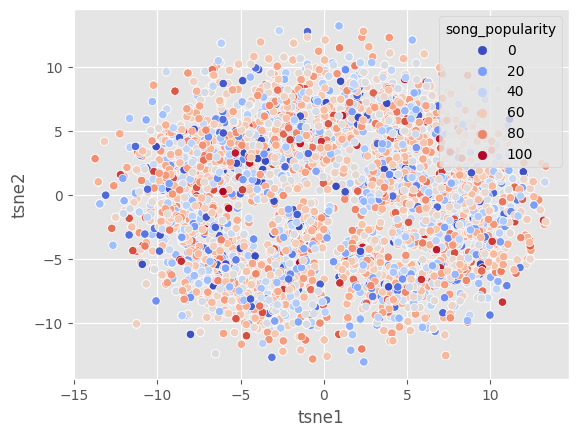

[t-SNE] Computing 37 nearest neighbors...
[t-SNE] Indexed 6997 samples in 0.004s...
[t-SNE] Computed neighbors for 6997 samples in 1.562s...
[t-SNE] Computed conditional probabilities for sample 1000 / 6997
[t-SNE] Computed conditional probabilities for sample 2000 / 6997
[t-SNE] Computed conditional probabilities for sample 3000 / 6997
[t-SNE] Computed conditional probabilities for sample 4000 / 6997
[t-SNE] Computed conditional probabilities for sample 5000 / 6997
[t-SNE] Computed conditional probabilities for sample 6000 / 6997
[t-SNE] Computed conditional probabilities for sample 6997 / 6997
[t-SNE] Mean sigma: 0.000000
[t-SNE] KL divergence after 250 iterations with early exaggeration: 92.372444
[t-SNE] KL divergence after 300 iterations: 3.228031


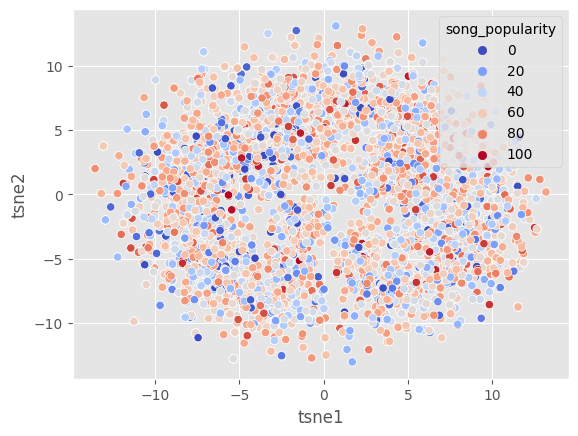

[t-SNE] Computing 40 nearest neighbors...
[t-SNE] Indexed 6997 samples in 0.005s...
[t-SNE] Computed neighbors for 6997 samples in 1.532s...
[t-SNE] Computed conditional probabilities for sample 1000 / 6997
[t-SNE] Computed conditional probabilities for sample 2000 / 6997
[t-SNE] Computed conditional probabilities for sample 3000 / 6997
[t-SNE] Computed conditional probabilities for sample 4000 / 6997
[t-SNE] Computed conditional probabilities for sample 5000 / 6997
[t-SNE] Computed conditional probabilities for sample 6000 / 6997
[t-SNE] Computed conditional probabilities for sample 6997 / 6997
[t-SNE] Mean sigma: 0.000000
[t-SNE] KL divergence after 250 iterations with early exaggeration: 91.940056
[t-SNE] KL divergence after 300 iterations: 3.188312


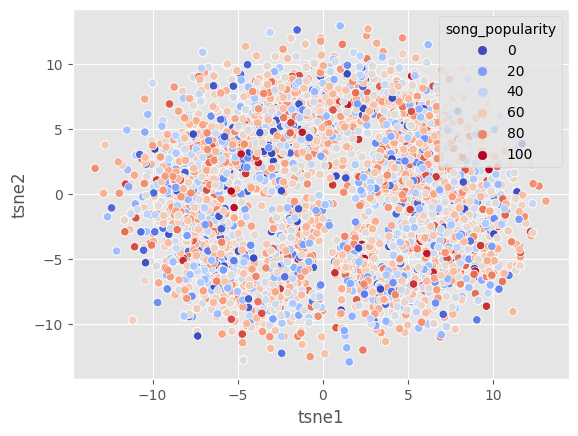

[t-SNE] Computing 43 nearest neighbors...
[t-SNE] Indexed 6997 samples in 0.005s...
[t-SNE] Computed neighbors for 6997 samples in 1.545s...
[t-SNE] Computed conditional probabilities for sample 1000 / 6997
[t-SNE] Computed conditional probabilities for sample 2000 / 6997
[t-SNE] Computed conditional probabilities for sample 3000 / 6997
[t-SNE] Computed conditional probabilities for sample 4000 / 6997
[t-SNE] Computed conditional probabilities for sample 5000 / 6997
[t-SNE] Computed conditional probabilities for sample 6000 / 6997
[t-SNE] Computed conditional probabilities for sample 6997 / 6997
[t-SNE] Mean sigma: 0.000000
[t-SNE] KL divergence after 250 iterations with early exaggeration: 91.587433
[t-SNE] KL divergence after 300 iterations: 3.150955


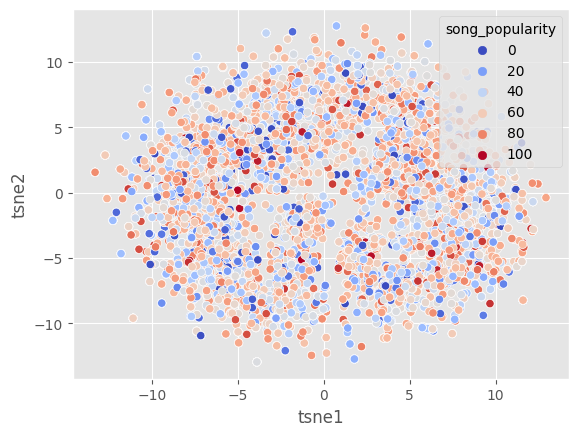

[t-SNE] Computing 46 nearest neighbors...
[t-SNE] Indexed 6997 samples in 0.005s...
[t-SNE] Computed neighbors for 6997 samples in 1.557s...
[t-SNE] Computed conditional probabilities for sample 1000 / 6997
[t-SNE] Computed conditional probabilities for sample 2000 / 6997
[t-SNE] Computed conditional probabilities for sample 3000 / 6997
[t-SNE] Computed conditional probabilities for sample 4000 / 6997
[t-SNE] Computed conditional probabilities for sample 5000 / 6997
[t-SNE] Computed conditional probabilities for sample 6000 / 6997
[t-SNE] Computed conditional probabilities for sample 6997 / 6997
[t-SNE] Mean sigma: 4.583767
[t-SNE] KL divergence after 250 iterations with early exaggeration: 91.374420
[t-SNE] KL divergence after 300 iterations: 3.116354


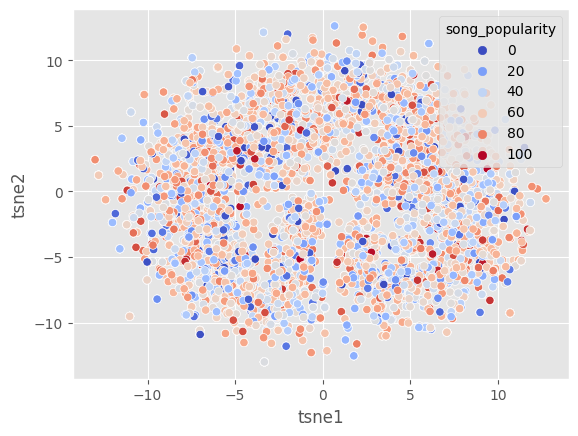

[t-SNE] Computing 49 nearest neighbors...
[t-SNE] Indexed 6997 samples in 0.005s...
[t-SNE] Computed neighbors for 6997 samples in 1.560s...
[t-SNE] Computed conditional probabilities for sample 1000 / 6997
[t-SNE] Computed conditional probabilities for sample 2000 / 6997
[t-SNE] Computed conditional probabilities for sample 3000 / 6997
[t-SNE] Computed conditional probabilities for sample 4000 / 6997
[t-SNE] Computed conditional probabilities for sample 5000 / 6997
[t-SNE] Computed conditional probabilities for sample 6000 / 6997
[t-SNE] Computed conditional probabilities for sample 6997 / 6997
[t-SNE] Mean sigma: 4.747883
[t-SNE] KL divergence after 250 iterations with early exaggeration: 91.191078
[t-SNE] KL divergence after 300 iterations: 3.085733


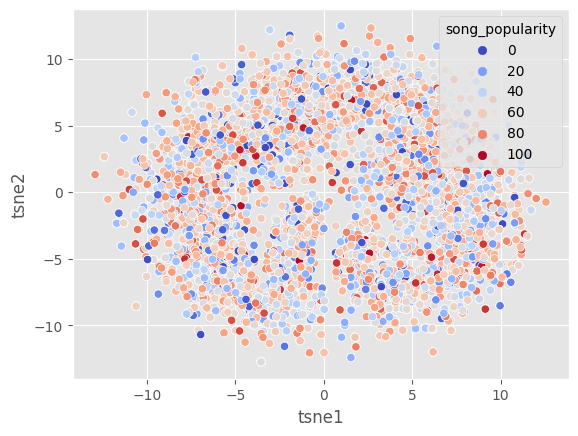

[t-SNE] Computing 52 nearest neighbors...
[t-SNE] Indexed 6997 samples in 0.005s...
[t-SNE] Computed neighbors for 6997 samples in 1.553s...
[t-SNE] Computed conditional probabilities for sample 1000 / 6997
[t-SNE] Computed conditional probabilities for sample 2000 / 6997
[t-SNE] Computed conditional probabilities for sample 3000 / 6997
[t-SNE] Computed conditional probabilities for sample 4000 / 6997
[t-SNE] Computed conditional probabilities for sample 5000 / 6997
[t-SNE] Computed conditional probabilities for sample 6000 / 6997
[t-SNE] Computed conditional probabilities for sample 6997 / 6997
[t-SNE] Mean sigma: 4.795019
[t-SNE] KL divergence after 250 iterations with early exaggeration: 90.707359
[t-SNE] KL divergence after 300 iterations: 3.055348


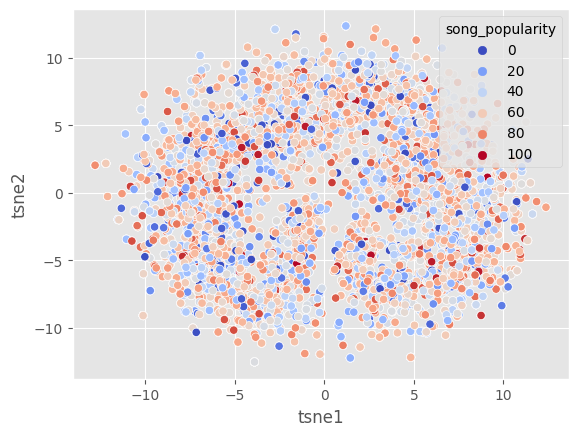

[t-SNE] Computing 55 nearest neighbors...
[t-SNE] Indexed 6997 samples in 0.005s...
[t-SNE] Computed neighbors for 6997 samples in 1.546s...
[t-SNE] Computed conditional probabilities for sample 1000 / 6997
[t-SNE] Computed conditional probabilities for sample 2000 / 6997
[t-SNE] Computed conditional probabilities for sample 3000 / 6997
[t-SNE] Computed conditional probabilities for sample 4000 / 6997
[t-SNE] Computed conditional probabilities for sample 5000 / 6997
[t-SNE] Computed conditional probabilities for sample 6000 / 6997
[t-SNE] Computed conditional probabilities for sample 6997 / 6997
[t-SNE] Mean sigma: 4.838450
[t-SNE] KL divergence after 250 iterations with early exaggeration: 90.526871
[t-SNE] KL divergence after 300 iterations: 3.028031


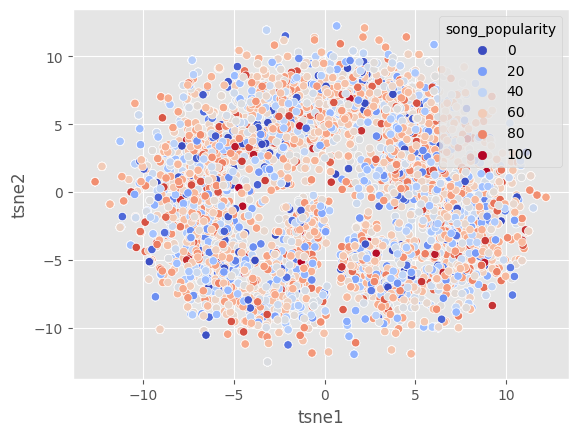

[t-SNE] Computing 58 nearest neighbors...
[t-SNE] Indexed 6997 samples in 0.006s...
[t-SNE] Computed neighbors for 6997 samples in 1.560s...
[t-SNE] Computed conditional probabilities for sample 1000 / 6997
[t-SNE] Computed conditional probabilities for sample 2000 / 6997
[t-SNE] Computed conditional probabilities for sample 3000 / 6997
[t-SNE] Computed conditional probabilities for sample 4000 / 6997
[t-SNE] Computed conditional probabilities for sample 5000 / 6997
[t-SNE] Computed conditional probabilities for sample 6000 / 6997
[t-SNE] Computed conditional probabilities for sample 6997 / 6997
[t-SNE] Mean sigma: 4.878709
[t-SNE] KL divergence after 250 iterations with early exaggeration: 90.257492
[t-SNE] KL divergence after 300 iterations: 3.000712


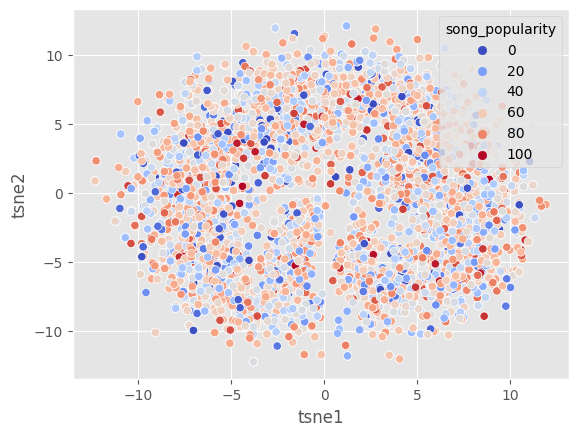

[t-SNE] Computing 61 nearest neighbors...
[t-SNE] Indexed 6997 samples in 0.004s...
[t-SNE] Computed neighbors for 6997 samples in 1.579s...
[t-SNE] Computed conditional probabilities for sample 1000 / 6997
[t-SNE] Computed conditional probabilities for sample 2000 / 6997
[t-SNE] Computed conditional probabilities for sample 3000 / 6997
[t-SNE] Computed conditional probabilities for sample 4000 / 6997
[t-SNE] Computed conditional probabilities for sample 5000 / 6997
[t-SNE] Computed conditional probabilities for sample 6000 / 6997
[t-SNE] Computed conditional probabilities for sample 6997 / 6997
[t-SNE] Mean sigma: 4.916202
[t-SNE] KL divergence after 250 iterations with early exaggeration: 89.781464
[t-SNE] KL divergence after 300 iterations: 2.976639


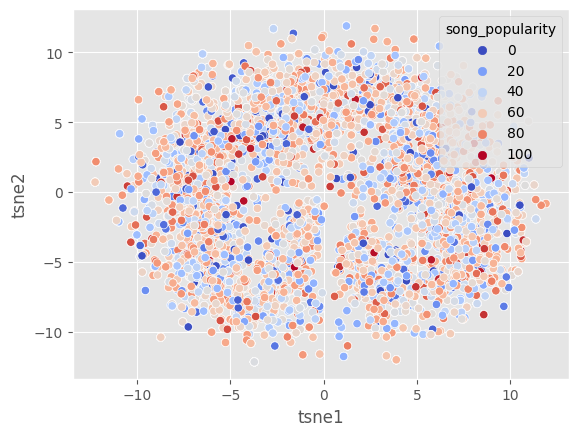

[t-SNE] Computing 64 nearest neighbors...
[t-SNE] Indexed 6997 samples in 0.005s...
[t-SNE] Computed neighbors for 6997 samples in 1.569s...
[t-SNE] Computed conditional probabilities for sample 1000 / 6997
[t-SNE] Computed conditional probabilities for sample 2000 / 6997
[t-SNE] Computed conditional probabilities for sample 3000 / 6997
[t-SNE] Computed conditional probabilities for sample 4000 / 6997
[t-SNE] Computed conditional probabilities for sample 5000 / 6997
[t-SNE] Computed conditional probabilities for sample 6000 / 6997
[t-SNE] Computed conditional probabilities for sample 6997 / 6997
[t-SNE] Mean sigma: 4.951274
[t-SNE] KL divergence after 250 iterations with early exaggeration: 89.656937
[t-SNE] KL divergence after 300 iterations: 2.952373


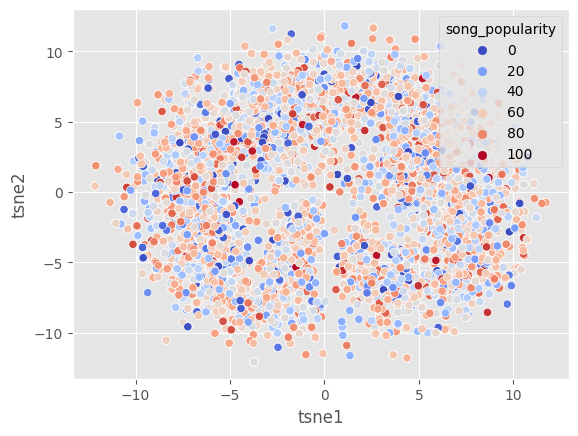

[t-SNE] Computing 67 nearest neighbors...
[t-SNE] Indexed 6997 samples in 0.005s...
[t-SNE] Computed neighbors for 6997 samples in 1.556s...
[t-SNE] Computed conditional probabilities for sample 1000 / 6997
[t-SNE] Computed conditional probabilities for sample 2000 / 6997
[t-SNE] Computed conditional probabilities for sample 3000 / 6997
[t-SNE] Computed conditional probabilities for sample 4000 / 6997
[t-SNE] Computed conditional probabilities for sample 5000 / 6997
[t-SNE] Computed conditional probabilities for sample 6000 / 6997
[t-SNE] Computed conditional probabilities for sample 6997 / 6997
[t-SNE] Mean sigma: 4.984197
[t-SNE] KL divergence after 250 iterations with early exaggeration: 89.396080
[t-SNE] KL divergence after 300 iterations: 2.929326


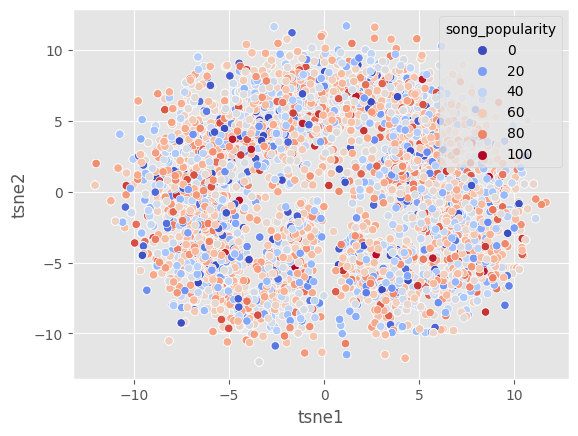

[t-SNE] Computing 70 nearest neighbors...
[t-SNE] Indexed 6997 samples in 0.006s...
[t-SNE] Computed neighbors for 6997 samples in 1.572s...
[t-SNE] Computed conditional probabilities for sample 1000 / 6997
[t-SNE] Computed conditional probabilities for sample 2000 / 6997
[t-SNE] Computed conditional probabilities for sample 3000 / 6997
[t-SNE] Computed conditional probabilities for sample 4000 / 6997
[t-SNE] Computed conditional probabilities for sample 5000 / 6997
[t-SNE] Computed conditional probabilities for sample 6000 / 6997
[t-SNE] Computed conditional probabilities for sample 6997 / 6997
[t-SNE] Mean sigma: 5.015177
[t-SNE] KL divergence after 250 iterations with early exaggeration: 89.224197
[t-SNE] KL divergence after 300 iterations: 2.906965


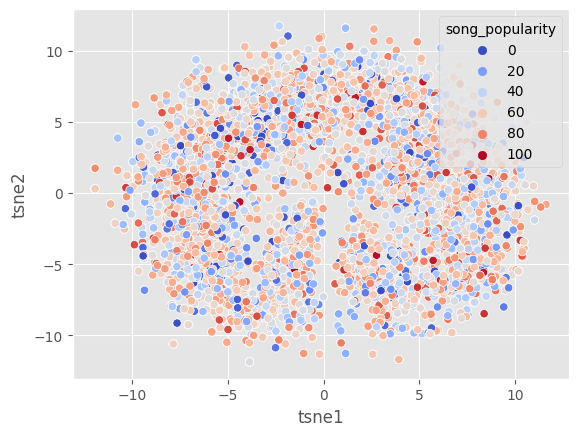

[t-SNE] Computing 73 nearest neighbors...
[t-SNE] Indexed 6997 samples in 0.006s...
[t-SNE] Computed neighbors for 6997 samples in 1.542s...
[t-SNE] Computed conditional probabilities for sample 1000 / 6997
[t-SNE] Computed conditional probabilities for sample 2000 / 6997
[t-SNE] Computed conditional probabilities for sample 3000 / 6997
[t-SNE] Computed conditional probabilities for sample 4000 / 6997
[t-SNE] Computed conditional probabilities for sample 5000 / 6997
[t-SNE] Computed conditional probabilities for sample 6000 / 6997
[t-SNE] Computed conditional probabilities for sample 6997 / 6997
[t-SNE] Mean sigma: 5.044444
[t-SNE] KL divergence after 250 iterations with early exaggeration: 88.851807
[t-SNE] KL divergence after 300 iterations: 2.887389


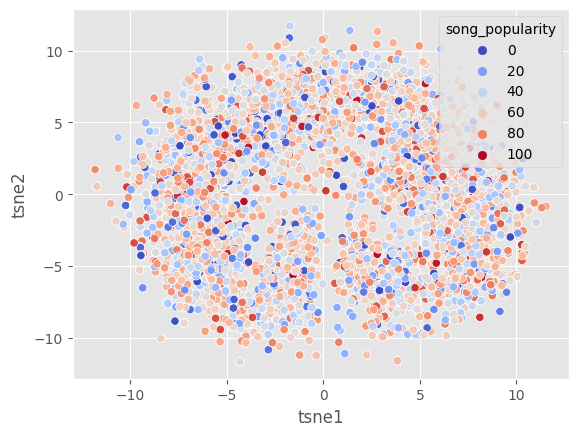

[t-SNE] Computing 76 nearest neighbors...
[t-SNE] Indexed 6997 samples in 0.005s...
[t-SNE] Computed neighbors for 6997 samples in 1.586s...
[t-SNE] Computed conditional probabilities for sample 1000 / 6997
[t-SNE] Computed conditional probabilities for sample 2000 / 6997
[t-SNE] Computed conditional probabilities for sample 3000 / 6997
[t-SNE] Computed conditional probabilities for sample 4000 / 6997
[t-SNE] Computed conditional probabilities for sample 5000 / 6997
[t-SNE] Computed conditional probabilities for sample 6000 / 6997
[t-SNE] Computed conditional probabilities for sample 6997 / 6997
[t-SNE] Mean sigma: 5.072157
[t-SNE] KL divergence after 250 iterations with early exaggeration: 88.458641
[t-SNE] KL divergence after 300 iterations: 2.867248


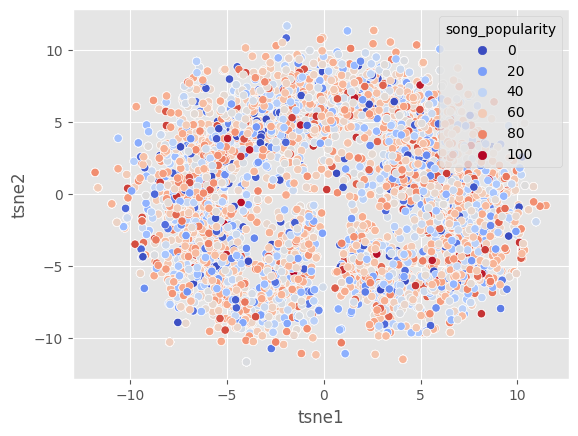

[t-SNE] Computing 79 nearest neighbors...
[t-SNE] Indexed 6997 samples in 0.006s...
[t-SNE] Computed neighbors for 6997 samples in 1.599s...
[t-SNE] Computed conditional probabilities for sample 1000 / 6997
[t-SNE] Computed conditional probabilities for sample 2000 / 6997
[t-SNE] Computed conditional probabilities for sample 3000 / 6997
[t-SNE] Computed conditional probabilities for sample 4000 / 6997
[t-SNE] Computed conditional probabilities for sample 5000 / 6997
[t-SNE] Computed conditional probabilities for sample 6000 / 6997
[t-SNE] Computed conditional probabilities for sample 6997 / 6997
[t-SNE] Mean sigma: 5.098462
[t-SNE] KL divergence after 250 iterations with early exaggeration: 88.362686
[t-SNE] KL divergence after 300 iterations: 2.849182


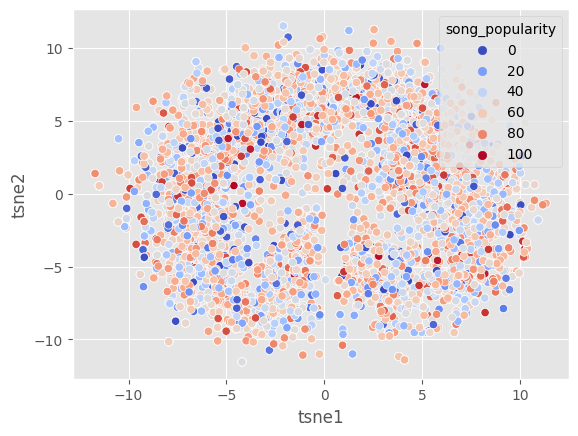

[t-SNE] Computing 82 nearest neighbors...
[t-SNE] Indexed 6997 samples in 0.005s...
[t-SNE] Computed neighbors for 6997 samples in 1.622s...
[t-SNE] Computed conditional probabilities for sample 1000 / 6997
[t-SNE] Computed conditional probabilities for sample 2000 / 6997
[t-SNE] Computed conditional probabilities for sample 3000 / 6997
[t-SNE] Computed conditional probabilities for sample 4000 / 6997
[t-SNE] Computed conditional probabilities for sample 5000 / 6997
[t-SNE] Computed conditional probabilities for sample 6000 / 6997
[t-SNE] Computed conditional probabilities for sample 6997 / 6997
[t-SNE] Mean sigma: 5.123491
[t-SNE] KL divergence after 250 iterations with early exaggeration: 87.954468
[t-SNE] KL divergence after 300 iterations: 2.831212


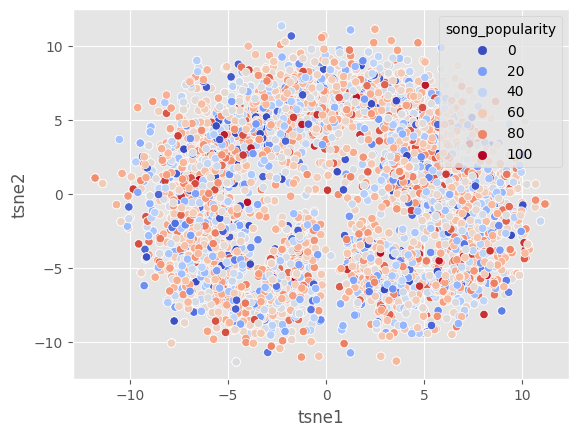

[t-SNE] Computing 85 nearest neighbors...
[t-SNE] Indexed 6997 samples in 0.005s...
[t-SNE] Computed neighbors for 6997 samples in 1.612s...
[t-SNE] Computed conditional probabilities for sample 1000 / 6997
[t-SNE] Computed conditional probabilities for sample 2000 / 6997
[t-SNE] Computed conditional probabilities for sample 3000 / 6997
[t-SNE] Computed conditional probabilities for sample 4000 / 6997
[t-SNE] Computed conditional probabilities for sample 5000 / 6997
[t-SNE] Computed conditional probabilities for sample 6000 / 6997
[t-SNE] Computed conditional probabilities for sample 6997 / 6997
[t-SNE] Mean sigma: 5.147350
[t-SNE] KL divergence after 250 iterations with early exaggeration: 87.933968
[t-SNE] KL divergence after 300 iterations: 2.812089


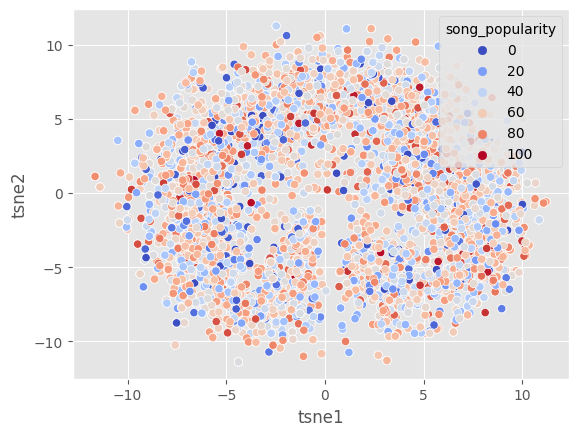

[t-SNE] Computing 88 nearest neighbors...
[t-SNE] Indexed 6997 samples in 0.005s...
[t-SNE] Computed neighbors for 6997 samples in 1.628s...
[t-SNE] Computed conditional probabilities for sample 1000 / 6997
[t-SNE] Computed conditional probabilities for sample 2000 / 6997
[t-SNE] Computed conditional probabilities for sample 3000 / 6997
[t-SNE] Computed conditional probabilities for sample 4000 / 6997
[t-SNE] Computed conditional probabilities for sample 5000 / 6997
[t-SNE] Computed conditional probabilities for sample 6000 / 6997
[t-SNE] Computed conditional probabilities for sample 6997 / 6997
[t-SNE] Mean sigma: 5.170140
[t-SNE] KL divergence after 250 iterations with early exaggeration: 87.820114
[t-SNE] KL divergence after 300 iterations: 2.794761


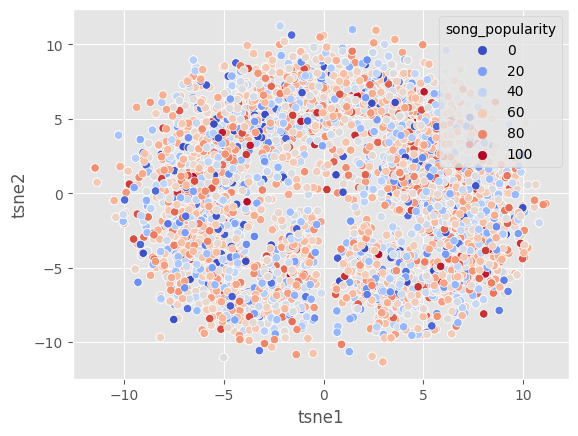

[t-SNE] Computing 91 nearest neighbors...
[t-SNE] Indexed 6997 samples in 0.005s...
[t-SNE] Computed neighbors for 6997 samples in 1.592s...
[t-SNE] Computed conditional probabilities for sample 1000 / 6997
[t-SNE] Computed conditional probabilities for sample 2000 / 6997
[t-SNE] Computed conditional probabilities for sample 3000 / 6997
[t-SNE] Computed conditional probabilities for sample 4000 / 6997
[t-SNE] Computed conditional probabilities for sample 5000 / 6997
[t-SNE] Computed conditional probabilities for sample 6000 / 6997
[t-SNE] Computed conditional probabilities for sample 6997 / 6997
[t-SNE] Mean sigma: 5.191940
[t-SNE] KL divergence after 250 iterations with early exaggeration: 87.577293
[t-SNE] KL divergence after 300 iterations: 2.780397


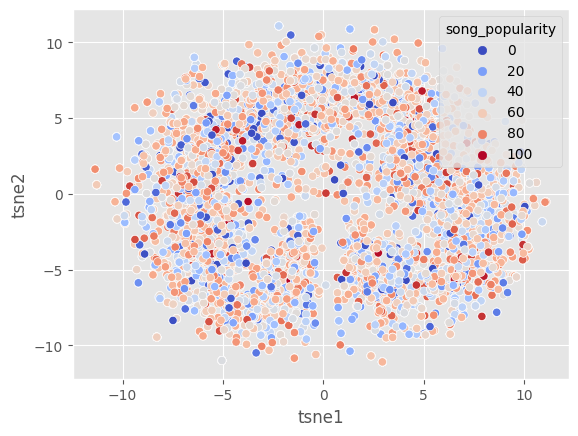

[t-SNE] Computing 94 nearest neighbors...
[t-SNE] Indexed 6997 samples in 0.005s...
[t-SNE] Computed neighbors for 6997 samples in 1.578s...
[t-SNE] Computed conditional probabilities for sample 1000 / 6997
[t-SNE] Computed conditional probabilities for sample 2000 / 6997
[t-SNE] Computed conditional probabilities for sample 3000 / 6997
[t-SNE] Computed conditional probabilities for sample 4000 / 6997
[t-SNE] Computed conditional probabilities for sample 5000 / 6997
[t-SNE] Computed conditional probabilities for sample 6000 / 6997
[t-SNE] Computed conditional probabilities for sample 6997 / 6997
[t-SNE] Mean sigma: 5.212828
[t-SNE] KL divergence after 250 iterations with early exaggeration: 87.013634
[t-SNE] KL divergence after 300 iterations: 2.764486


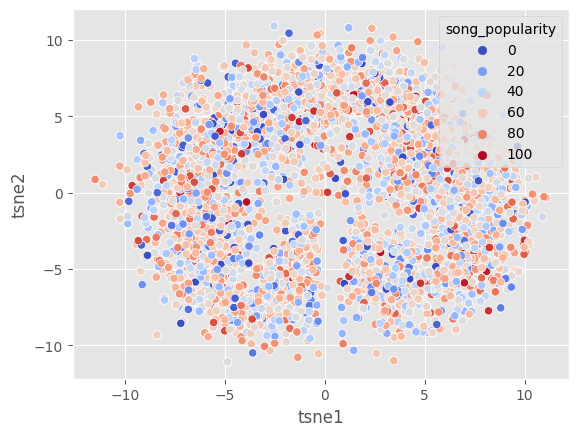

[t-SNE] Computing 97 nearest neighbors...
[t-SNE] Indexed 6997 samples in 0.005s...
[t-SNE] Computed neighbors for 6997 samples in 1.586s...
[t-SNE] Computed conditional probabilities for sample 1000 / 6997
[t-SNE] Computed conditional probabilities for sample 2000 / 6997
[t-SNE] Computed conditional probabilities for sample 3000 / 6997
[t-SNE] Computed conditional probabilities for sample 4000 / 6997
[t-SNE] Computed conditional probabilities for sample 5000 / 6997
[t-SNE] Computed conditional probabilities for sample 6000 / 6997
[t-SNE] Computed conditional probabilities for sample 6997 / 6997
[t-SNE] Mean sigma: 5.232897
[t-SNE] KL divergence after 250 iterations with early exaggeration: 87.126923
[t-SNE] KL divergence after 300 iterations: 2.751615


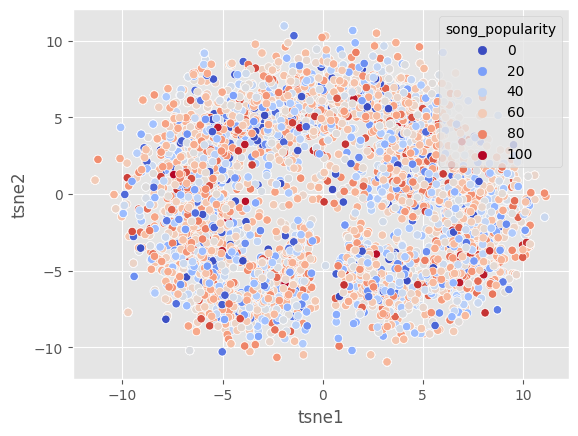

[t-SNE] Computing 100 nearest neighbors...
[t-SNE] Indexed 6997 samples in 0.005s...
[t-SNE] Computed neighbors for 6997 samples in 1.639s...
[t-SNE] Computed conditional probabilities for sample 1000 / 6997
[t-SNE] Computed conditional probabilities for sample 2000 / 6997
[t-SNE] Computed conditional probabilities for sample 3000 / 6997
[t-SNE] Computed conditional probabilities for sample 4000 / 6997
[t-SNE] Computed conditional probabilities for sample 5000 / 6997
[t-SNE] Computed conditional probabilities for sample 6000 / 6997
[t-SNE] Computed conditional probabilities for sample 6997 / 6997
[t-SNE] Mean sigma: 5.252193
[t-SNE] KL divergence after 250 iterations with early exaggeration: 86.880356
[t-SNE] KL divergence after 300 iterations: 2.738794


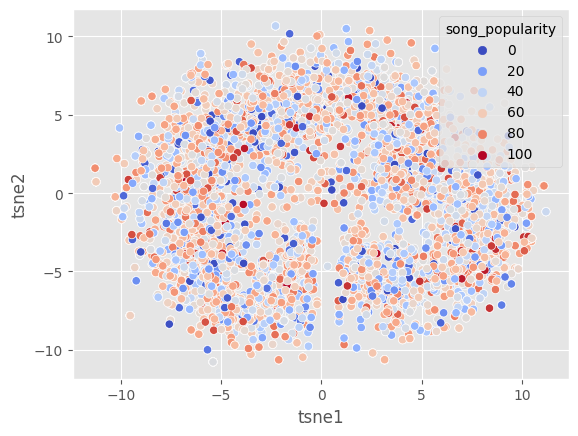

[t-SNE] Computing 103 nearest neighbors...
[t-SNE] Indexed 6997 samples in 0.006s...
[t-SNE] Computed neighbors for 6997 samples in 1.634s...
[t-SNE] Computed conditional probabilities for sample 1000 / 6997
[t-SNE] Computed conditional probabilities for sample 2000 / 6997
[t-SNE] Computed conditional probabilities for sample 3000 / 6997
[t-SNE] Computed conditional probabilities for sample 4000 / 6997
[t-SNE] Computed conditional probabilities for sample 5000 / 6997
[t-SNE] Computed conditional probabilities for sample 6000 / 6997
[t-SNE] Computed conditional probabilities for sample 6997 / 6997
[t-SNE] Mean sigma: 5.270769
[t-SNE] KL divergence after 250 iterations with early exaggeration: 86.421013
[t-SNE] KL divergence after 300 iterations: 2.728205


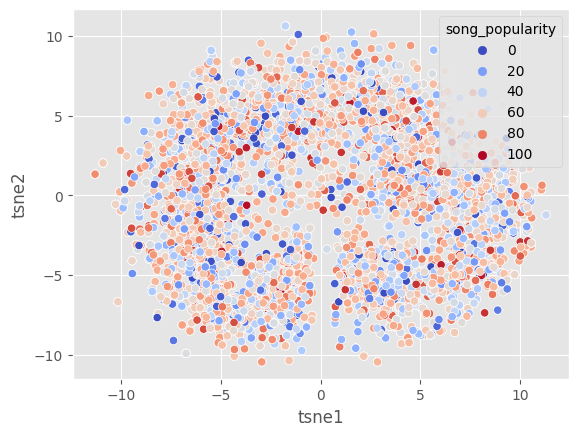

[t-SNE] Computing 106 nearest neighbors...
[t-SNE] Indexed 6997 samples in 0.005s...
[t-SNE] Computed neighbors for 6997 samples in 1.608s...
[t-SNE] Computed conditional probabilities for sample 1000 / 6997
[t-SNE] Computed conditional probabilities for sample 2000 / 6997
[t-SNE] Computed conditional probabilities for sample 3000 / 6997
[t-SNE] Computed conditional probabilities for sample 4000 / 6997
[t-SNE] Computed conditional probabilities for sample 5000 / 6997
[t-SNE] Computed conditional probabilities for sample 6000 / 6997
[t-SNE] Computed conditional probabilities for sample 6997 / 6997
[t-SNE] Mean sigma: 5.288670
[t-SNE] KL divergence after 250 iterations with early exaggeration: 86.431259
[t-SNE] KL divergence after 300 iterations: 2.713523


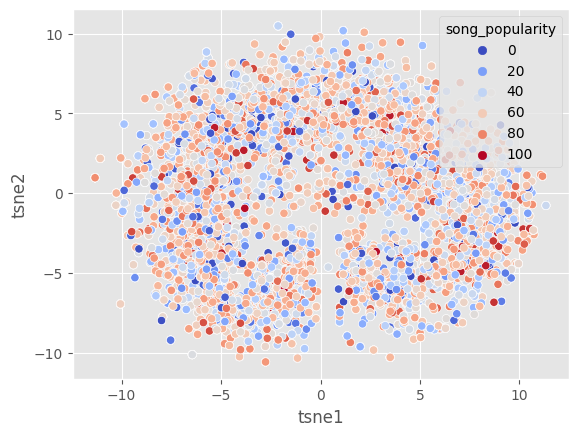

[t-SNE] Computing 109 nearest neighbors...
[t-SNE] Indexed 6997 samples in 0.005s...
[t-SNE] Computed neighbors for 6997 samples in 1.612s...
[t-SNE] Computed conditional probabilities for sample 1000 / 6997
[t-SNE] Computed conditional probabilities for sample 2000 / 6997
[t-SNE] Computed conditional probabilities for sample 3000 / 6997
[t-SNE] Computed conditional probabilities for sample 4000 / 6997
[t-SNE] Computed conditional probabilities for sample 5000 / 6997
[t-SNE] Computed conditional probabilities for sample 6000 / 6997
[t-SNE] Computed conditional probabilities for sample 6997 / 6997
[t-SNE] Mean sigma: 5.305948
[t-SNE] KL divergence after 250 iterations with early exaggeration: 86.072121
[t-SNE] KL divergence after 300 iterations: 2.711207


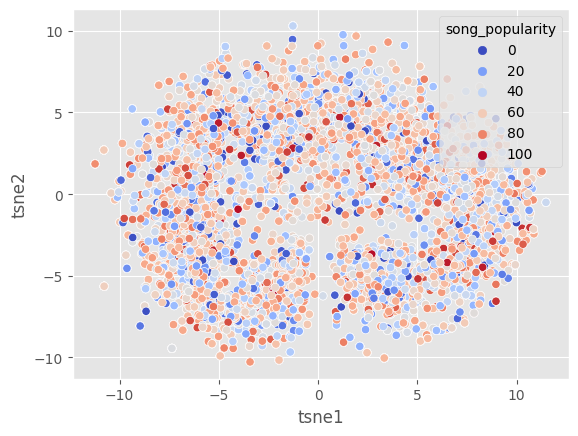

[t-SNE] Computing 112 nearest neighbors...
[t-SNE] Indexed 6997 samples in 0.006s...
[t-SNE] Computed neighbors for 6997 samples in 1.640s...
[t-SNE] Computed conditional probabilities for sample 1000 / 6997
[t-SNE] Computed conditional probabilities for sample 2000 / 6997
[t-SNE] Computed conditional probabilities for sample 3000 / 6997
[t-SNE] Computed conditional probabilities for sample 4000 / 6997
[t-SNE] Computed conditional probabilities for sample 5000 / 6997
[t-SNE] Computed conditional probabilities for sample 6000 / 6997
[t-SNE] Computed conditional probabilities for sample 6997 / 6997
[t-SNE] Mean sigma: 5.322647
[t-SNE] KL divergence after 250 iterations with early exaggeration: 86.211723
[t-SNE] KL divergence after 300 iterations: 2.706914


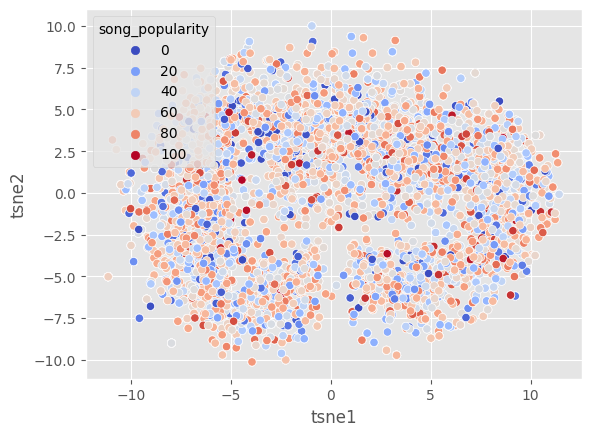

[t-SNE] Computing 115 nearest neighbors...
[t-SNE] Indexed 6997 samples in 0.005s...
[t-SNE] Computed neighbors for 6997 samples in 1.637s...
[t-SNE] Computed conditional probabilities for sample 1000 / 6997
[t-SNE] Computed conditional probabilities for sample 2000 / 6997
[t-SNE] Computed conditional probabilities for sample 3000 / 6997
[t-SNE] Computed conditional probabilities for sample 4000 / 6997
[t-SNE] Computed conditional probabilities for sample 5000 / 6997
[t-SNE] Computed conditional probabilities for sample 6000 / 6997
[t-SNE] Computed conditional probabilities for sample 6997 / 6997
[t-SNE] Mean sigma: 5.338808
[t-SNE] KL divergence after 250 iterations with early exaggeration: 85.644928
[t-SNE] KL divergence after 300 iterations: 2.714050


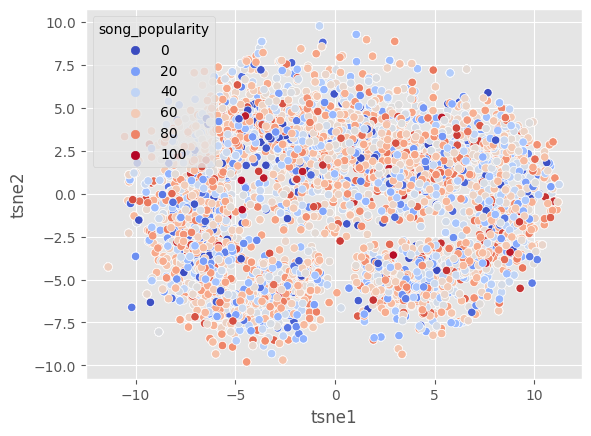

[t-SNE] Computing 118 nearest neighbors...
[t-SNE] Indexed 6997 samples in 0.005s...
[t-SNE] Computed neighbors for 6997 samples in 1.623s...
[t-SNE] Computed conditional probabilities for sample 1000 / 6997
[t-SNE] Computed conditional probabilities for sample 2000 / 6997
[t-SNE] Computed conditional probabilities for sample 3000 / 6997
[t-SNE] Computed conditional probabilities for sample 4000 / 6997
[t-SNE] Computed conditional probabilities for sample 5000 / 6997
[t-SNE] Computed conditional probabilities for sample 6000 / 6997
[t-SNE] Computed conditional probabilities for sample 6997 / 6997
[t-SNE] Mean sigma: 5.354459
[t-SNE] KL divergence after 250 iterations with early exaggeration: 85.560059
[t-SNE] KL divergence after 300 iterations: 2.709966


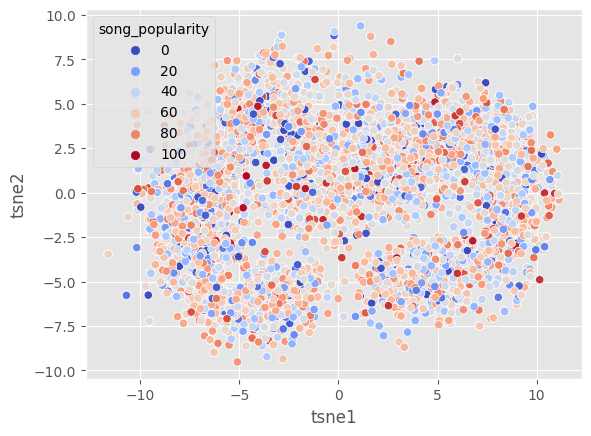

[t-SNE] Computing 121 nearest neighbors...
[t-SNE] Indexed 6997 samples in 0.005s...
[t-SNE] Computed neighbors for 6997 samples in 1.613s...
[t-SNE] Computed conditional probabilities for sample 1000 / 6997
[t-SNE] Computed conditional probabilities for sample 2000 / 6997
[t-SNE] Computed conditional probabilities for sample 3000 / 6997
[t-SNE] Computed conditional probabilities for sample 4000 / 6997
[t-SNE] Computed conditional probabilities for sample 5000 / 6997
[t-SNE] Computed conditional probabilities for sample 6000 / 6997
[t-SNE] Computed conditional probabilities for sample 6997 / 6997
[t-SNE] Mean sigma: 5.369637
[t-SNE] KL divergence after 250 iterations with early exaggeration: 85.092316
[t-SNE] KL divergence after 300 iterations: 2.719095


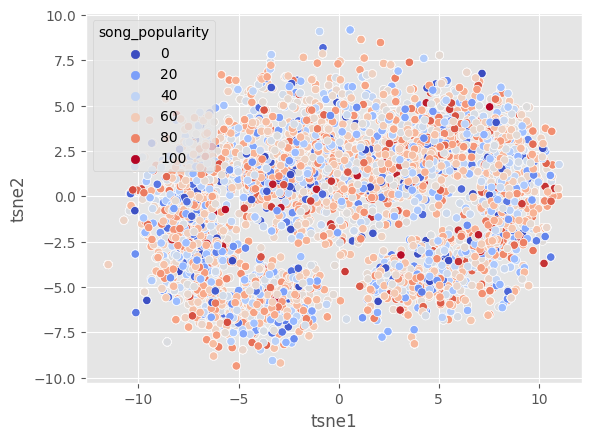

[t-SNE] Computing 124 nearest neighbors...
[t-SNE] Indexed 6997 samples in 0.005s...
[t-SNE] Computed neighbors for 6997 samples in 1.631s...
[t-SNE] Computed conditional probabilities for sample 1000 / 6997
[t-SNE] Computed conditional probabilities for sample 2000 / 6997
[t-SNE] Computed conditional probabilities for sample 3000 / 6997
[t-SNE] Computed conditional probabilities for sample 4000 / 6997
[t-SNE] Computed conditional probabilities for sample 5000 / 6997
[t-SNE] Computed conditional probabilities for sample 6000 / 6997
[t-SNE] Computed conditional probabilities for sample 6997 / 6997
[t-SNE] Mean sigma: 5.384364
[t-SNE] KL divergence after 250 iterations with early exaggeration: 84.921600
[t-SNE] KL divergence after 300 iterations: 2.708596


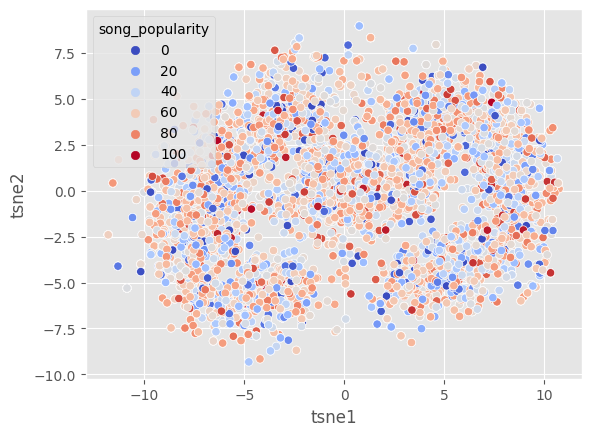

[t-SNE] Computing 127 nearest neighbors...
[t-SNE] Indexed 6997 samples in 0.005s...
[t-SNE] Computed neighbors for 6997 samples in 1.618s...
[t-SNE] Computed conditional probabilities for sample 1000 / 6997
[t-SNE] Computed conditional probabilities for sample 2000 / 6997
[t-SNE] Computed conditional probabilities for sample 3000 / 6997
[t-SNE] Computed conditional probabilities for sample 4000 / 6997
[t-SNE] Computed conditional probabilities for sample 5000 / 6997
[t-SNE] Computed conditional probabilities for sample 6000 / 6997
[t-SNE] Computed conditional probabilities for sample 6997 / 6997
[t-SNE] Mean sigma: 5.398664
[t-SNE] KL divergence after 250 iterations with early exaggeration: 84.938515
[t-SNE] KL divergence after 300 iterations: 2.728328


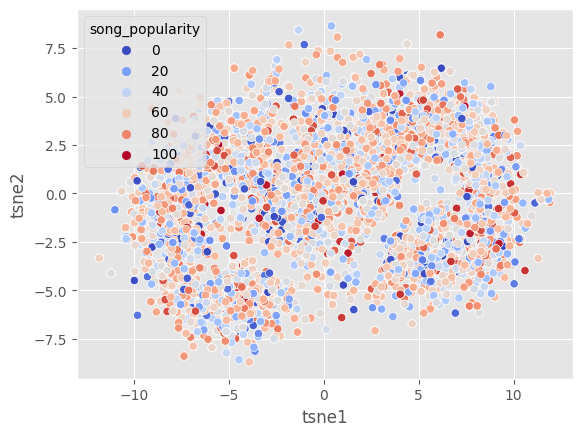

[t-SNE] Computing 130 nearest neighbors...
[t-SNE] Indexed 6997 samples in 0.005s...
[t-SNE] Computed neighbors for 6997 samples in 1.780s...
[t-SNE] Computed conditional probabilities for sample 1000 / 6997
[t-SNE] Computed conditional probabilities for sample 2000 / 6997
[t-SNE] Computed conditional probabilities for sample 3000 / 6997
[t-SNE] Computed conditional probabilities for sample 4000 / 6997
[t-SNE] Computed conditional probabilities for sample 5000 / 6997
[t-SNE] Computed conditional probabilities for sample 6000 / 6997
[t-SNE] Computed conditional probabilities for sample 6997 / 6997
[t-SNE] Mean sigma: 5.412562
[t-SNE] KL divergence after 250 iterations with early exaggeration: 84.740822
[t-SNE] KL divergence after 300 iterations: 2.703722


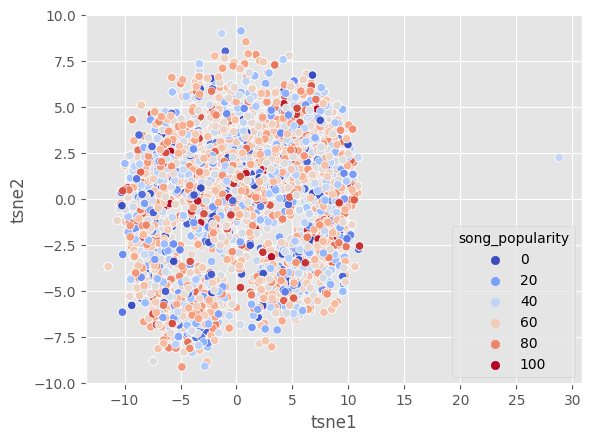

[t-SNE] Computing 133 nearest neighbors...
[t-SNE] Indexed 6997 samples in 0.005s...
[t-SNE] Computed neighbors for 6997 samples in 1.631s...
[t-SNE] Computed conditional probabilities for sample 1000 / 6997
[t-SNE] Computed conditional probabilities for sample 2000 / 6997
[t-SNE] Computed conditional probabilities for sample 3000 / 6997
[t-SNE] Computed conditional probabilities for sample 4000 / 6997
[t-SNE] Computed conditional probabilities for sample 5000 / 6997
[t-SNE] Computed conditional probabilities for sample 6000 / 6997
[t-SNE] Computed conditional probabilities for sample 6997 / 6997
[t-SNE] Mean sigma: 5.426086
[t-SNE] KL divergence after 250 iterations with early exaggeration: 84.385162
[t-SNE] KL divergence after 300 iterations: 2.700048


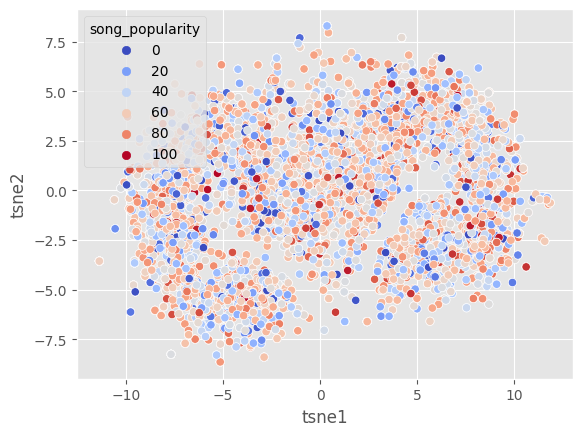

[t-SNE] Computing 136 nearest neighbors...
[t-SNE] Indexed 6997 samples in 0.005s...
[t-SNE] Computed neighbors for 6997 samples in 1.648s...
[t-SNE] Computed conditional probabilities for sample 1000 / 6997
[t-SNE] Computed conditional probabilities for sample 2000 / 6997
[t-SNE] Computed conditional probabilities for sample 3000 / 6997
[t-SNE] Computed conditional probabilities for sample 4000 / 6997
[t-SNE] Computed conditional probabilities for sample 5000 / 6997
[t-SNE] Computed conditional probabilities for sample 6000 / 6997
[t-SNE] Computed conditional probabilities for sample 6997 / 6997
[t-SNE] Mean sigma: 5.439256
[t-SNE] KL divergence after 250 iterations with early exaggeration: 84.194664
[t-SNE] KL divergence after 300 iterations: 2.766060


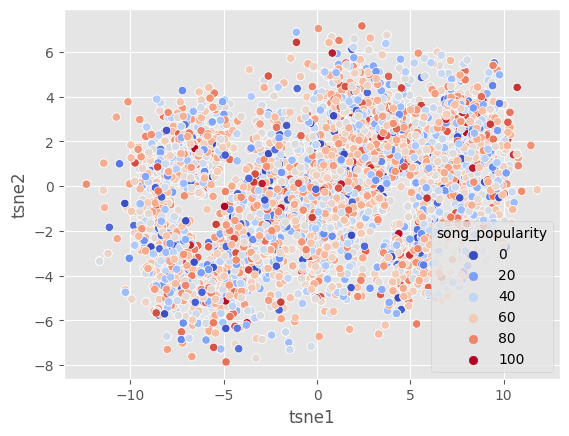

[t-SNE] Computing 139 nearest neighbors...
[t-SNE] Indexed 6997 samples in 0.006s...
[t-SNE] Computed neighbors for 6997 samples in 1.674s...
[t-SNE] Computed conditional probabilities for sample 1000 / 6997
[t-SNE] Computed conditional probabilities for sample 2000 / 6997
[t-SNE] Computed conditional probabilities for sample 3000 / 6997
[t-SNE] Computed conditional probabilities for sample 4000 / 6997
[t-SNE] Computed conditional probabilities for sample 5000 / 6997
[t-SNE] Computed conditional probabilities for sample 6000 / 6997
[t-SNE] Computed conditional probabilities for sample 6997 / 6997
[t-SNE] Mean sigma: 5.452089
[t-SNE] KL divergence after 250 iterations with early exaggeration: 83.944199
[t-SNE] KL divergence after 300 iterations: 2.720812


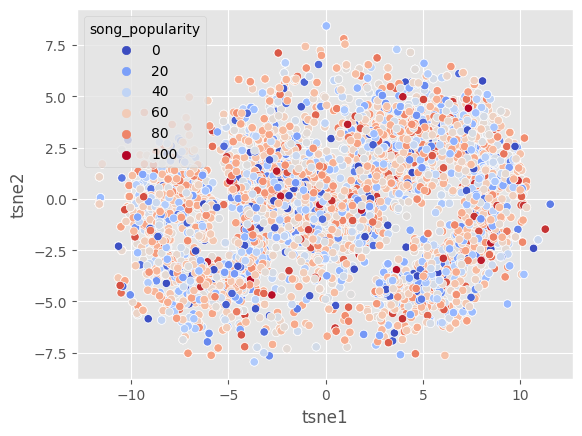

[t-SNE] Computing 142 nearest neighbors...
[t-SNE] Indexed 6997 samples in 0.005s...
[t-SNE] Computed neighbors for 6997 samples in 1.693s...
[t-SNE] Computed conditional probabilities for sample 1000 / 6997
[t-SNE] Computed conditional probabilities for sample 2000 / 6997
[t-SNE] Computed conditional probabilities for sample 3000 / 6997
[t-SNE] Computed conditional probabilities for sample 4000 / 6997
[t-SNE] Computed conditional probabilities for sample 5000 / 6997
[t-SNE] Computed conditional probabilities for sample 6000 / 6997
[t-SNE] Computed conditional probabilities for sample 6997 / 6997
[t-SNE] Mean sigma: 5.464602
[t-SNE] KL divergence after 250 iterations with early exaggeration: 83.531624
[t-SNE] KL divergence after 300 iterations: 2.734519


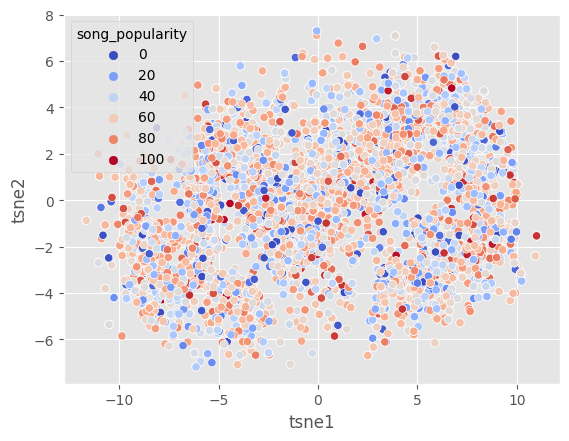

[t-SNE] Computing 145 nearest neighbors...
[t-SNE] Indexed 6997 samples in 0.005s...
[t-SNE] Computed neighbors for 6997 samples in 1.647s...
[t-SNE] Computed conditional probabilities for sample 1000 / 6997
[t-SNE] Computed conditional probabilities for sample 2000 / 6997
[t-SNE] Computed conditional probabilities for sample 3000 / 6997
[t-SNE] Computed conditional probabilities for sample 4000 / 6997
[t-SNE] Computed conditional probabilities for sample 5000 / 6997
[t-SNE] Computed conditional probabilities for sample 6000 / 6997
[t-SNE] Computed conditional probabilities for sample 6997 / 6997
[t-SNE] Mean sigma: 5.476801
[t-SNE] KL divergence after 250 iterations with early exaggeration: 83.552452
[t-SNE] KL divergence after 300 iterations: 2.718464


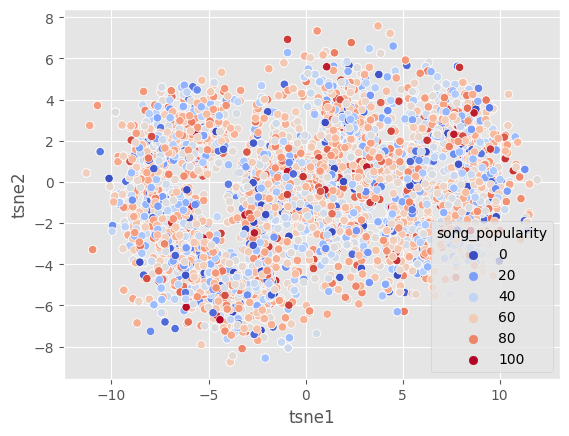

[t-SNE] Computing 148 nearest neighbors...
[t-SNE] Indexed 6997 samples in 0.006s...
[t-SNE] Computed neighbors for 6997 samples in 1.643s...
[t-SNE] Computed conditional probabilities for sample 1000 / 6997
[t-SNE] Computed conditional probabilities for sample 2000 / 6997
[t-SNE] Computed conditional probabilities for sample 3000 / 6997
[t-SNE] Computed conditional probabilities for sample 4000 / 6997
[t-SNE] Computed conditional probabilities for sample 5000 / 6997
[t-SNE] Computed conditional probabilities for sample 6000 / 6997
[t-SNE] Computed conditional probabilities for sample 6997 / 6997
[t-SNE] Mean sigma: 5.488705
[t-SNE] KL divergence after 250 iterations with early exaggeration: 83.473335
[t-SNE] KL divergence after 300 iterations: 2.726257


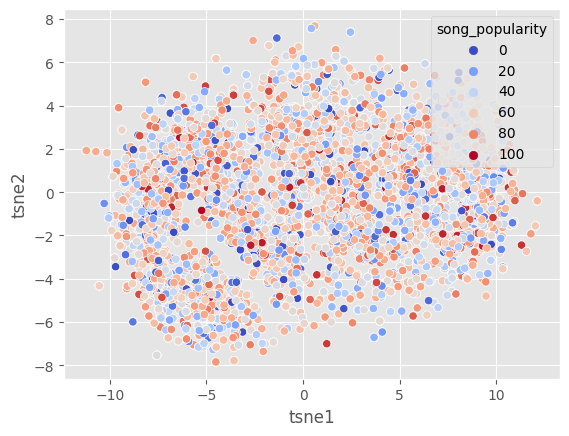

[t-SNE] Computing 151 nearest neighbors...
[t-SNE] Indexed 6997 samples in 0.005s...
[t-SNE] Computed neighbors for 6997 samples in 1.613s...
[t-SNE] Computed conditional probabilities for sample 1000 / 6997
[t-SNE] Computed conditional probabilities for sample 2000 / 6997
[t-SNE] Computed conditional probabilities for sample 3000 / 6997
[t-SNE] Computed conditional probabilities for sample 4000 / 6997
[t-SNE] Computed conditional probabilities for sample 5000 / 6997
[t-SNE] Computed conditional probabilities for sample 6000 / 6997
[t-SNE] Computed conditional probabilities for sample 6997 / 6997
[t-SNE] Mean sigma: 5.500325
[t-SNE] KL divergence after 250 iterations with early exaggeration: 83.212242
[t-SNE] KL divergence after 300 iterations: 2.707643


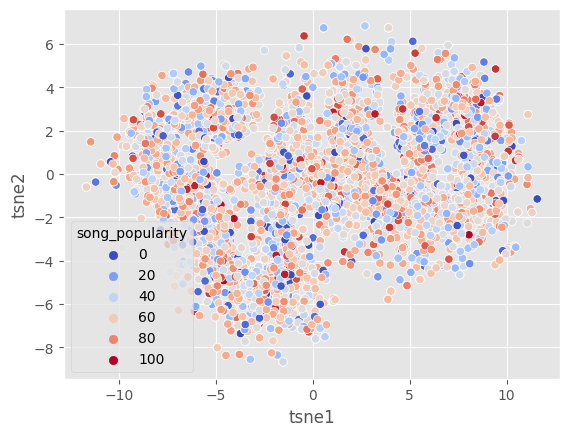

In [ ]:
from sklearn.manifold import TSNE
for perplexity in range(5, 51):
    tsne = TSNE(n_components=2, verbose=1, perplexity=perplexity, n_iter=300, init='pca')
    tsne_results = pd.DataFrame(tsne.fit_transform(w2v_df), columns=['tsne1', 'tsne2'])

    sns.scatterplot(x='tsne1', y='tsne2', data=tsne_results, hue=w2v_target, palette='coolwarm')
    plt.show()

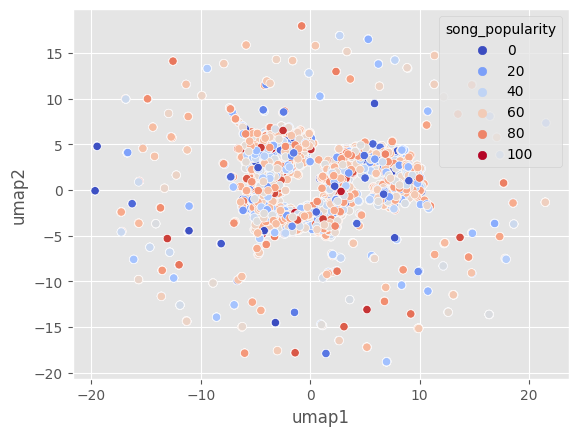

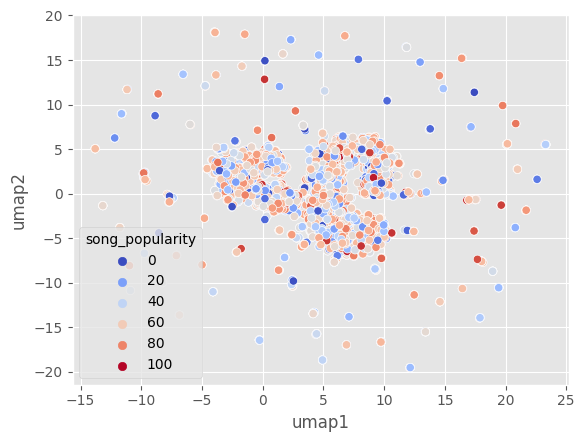

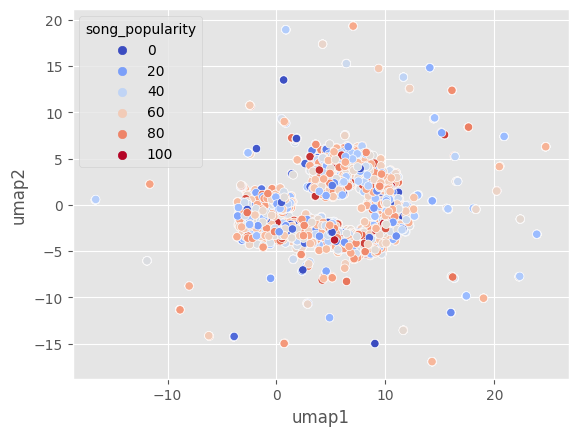

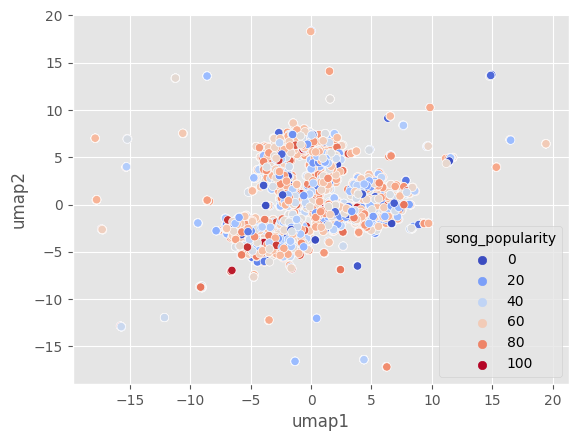

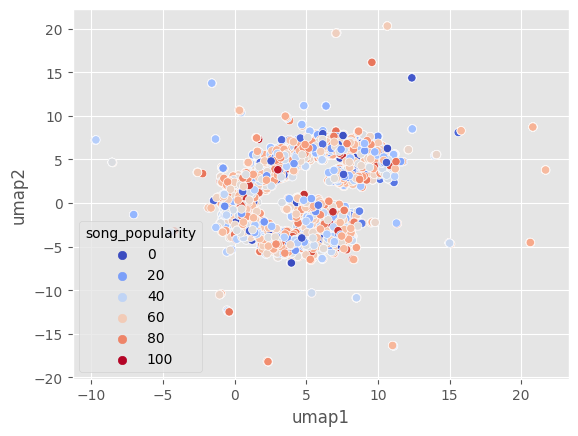

...

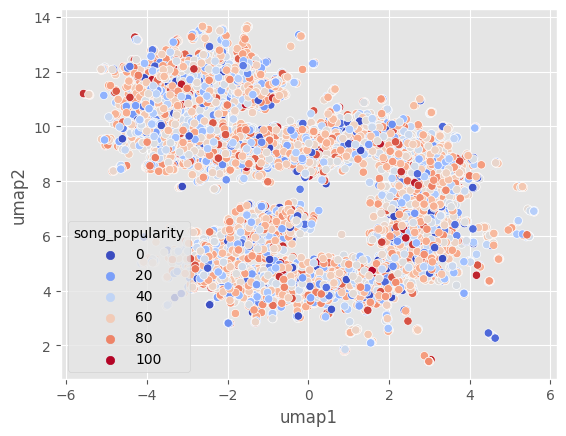

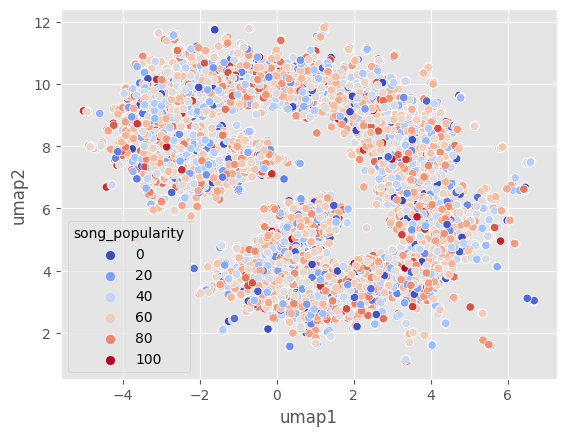

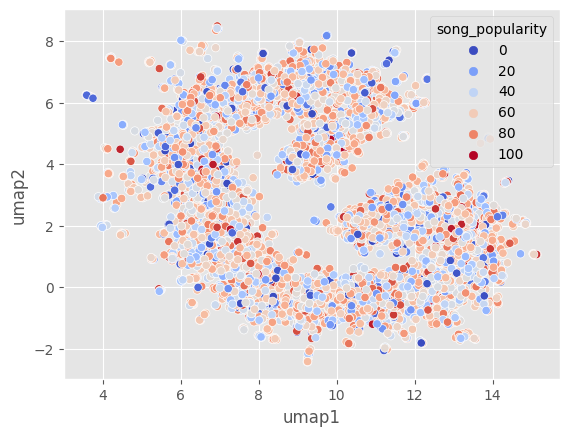

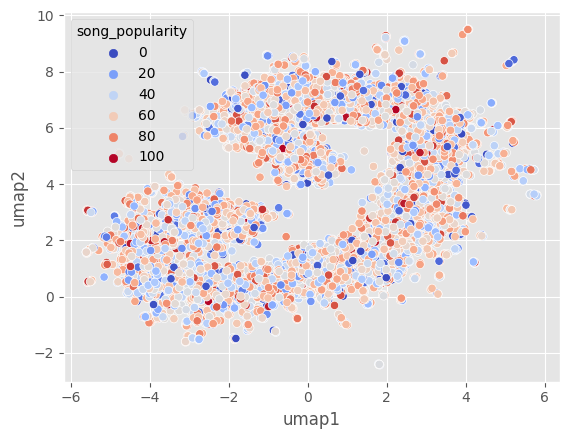

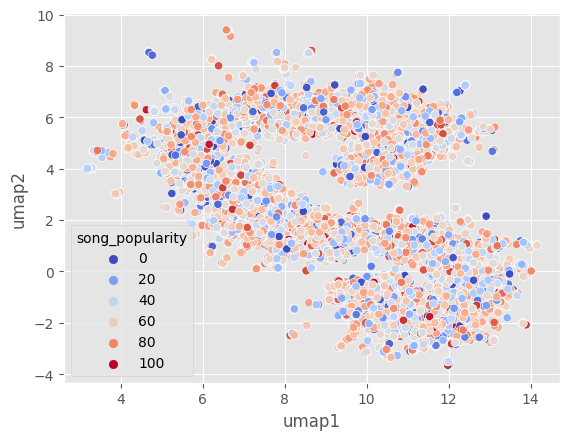

In [256]:
# try UMAP
import umap.umap_ as umap
for n_neighbors in range(5, 51):
    umap_results = umap.UMAP(n_neighbors=n_neighbors, min_dist=0.3, n_components=2).fit_transform(w2v_df)
    umap_results = pd.DataFrame(umap_results, columns=['umap1', 'umap2'])

    sns.scatterplot(x='umap1', y='umap2', data=umap_results, hue=w2v_target, palette='coolwarm')
    plt.show()

<AxesSubplot: xlabel='pca1', ylabel='pca2'>

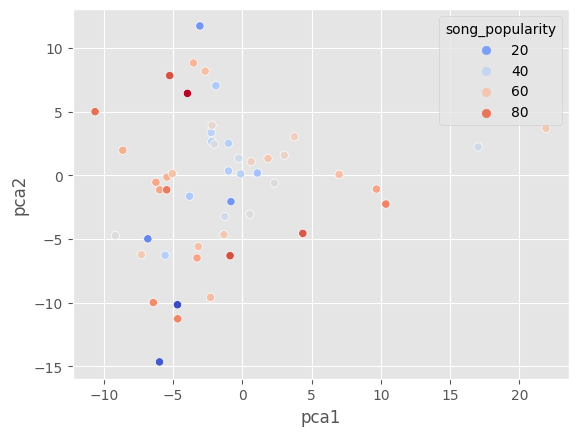

In [127]:
pca = PCA(n_components=2)
w2v_pca = pd.DataFrame(pca.fit_transform(w2v_df.loc[subset_index]), columns=['pca1', 'pca2'])

sns.scatterplot(x='pca1', y='pca2', data=w2v_pca, hue=w2v_target[subset_index], palette='coolwarm')

[t-SNE] Computing 91 nearest neighbors...
[t-SNE] Indexed 100 samples in 0.001s...
[t-SNE] Computed neighbors for 100 samples in 0.002s...
[t-SNE] Computed conditional probabilities for sample 100 / 100
[t-SNE] Mean sigma: 10.183113
[t-SNE] KL divergence after 250 iterations with early exaggeration: 85.259727
[t-SNE] KL divergence after 300 iterations: 1.442581


<AxesSubplot: xlabel='tsne1', ylabel='tsne2'>

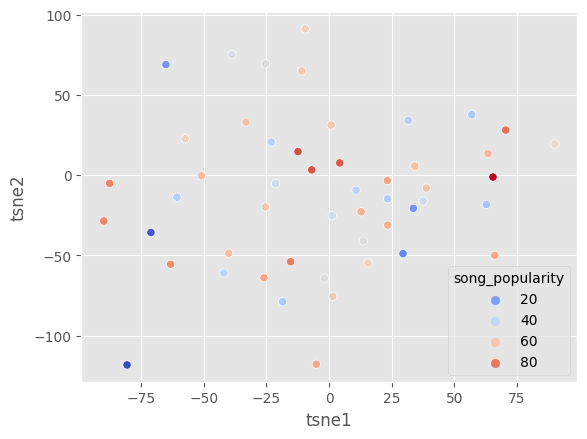

In [126]:
tsne = TSNE(n_components=2, verbose=1, perplexity=30, n_iter=300, init='pca')
tsne_results = pd.DataFrame(tsne.fit_transform(w2v_df.loc[subset_index]), columns=['tsne1', 'tsne2'])

sns.scatterplot(x='tsne1', y='tsne2', data=tsne_results, hue=w2v_target[subset_index], palette='coolwarm')

<AxesSubplot: xlabel='umap1', ylabel='umap2'>

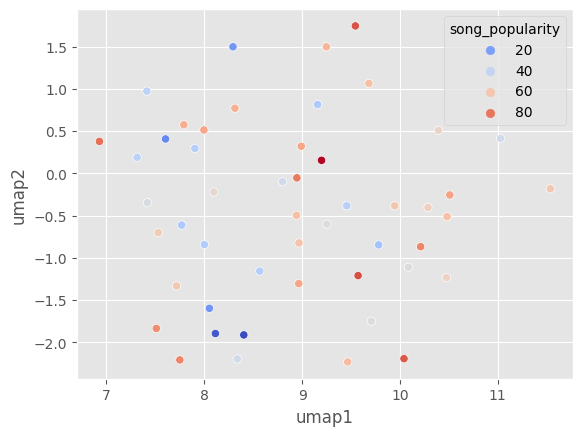

In [125]:
umap = UMAP(n_neighbors=30, min_dist=0.3, n_components=2)
umap_results = pd.DataFrame(umap.fit_transform(w2v_df.loc[subset_index]), columns=['umap1', 'umap2'])

sns.scatterplot(x='umap1', y='umap2', data=umap_results, hue=w2v_target[subset_index], palette='coolwarm')